# Step 2 -- Neuron Population Analysis and Visualization

**When looking into a specific variable, cells can be compared by GI section, plexus, responder vs spontaneous, etc. by filtering cells by it's value in a certain column of the csv.**

# Importing matplotlib, numpy, and other libraries

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks, peak_prominences, find_peaks_cwt
from scipy import signal
from numpy.fft import fft, ifft
from operator import itemgetter
from pybaselines import Baseline, utils
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
import time
from matplotlib.backends.backend_tkagg import FigureCanvasTkAgg
import tkinter as tk
from tkinter import*
from matplotlib.figure import Figure
import csv
import matplotlib.pyplot as plt
from matplotlib.patches import Circle, Rectangle, Ellipse
import numpy as np
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
import matplotlib as mpl

In [2]:
# coordinates of where the stimulus was applied compared to imaging FOV -- for visaualization grids
stimLocations = [[0,1], [1,1], [1,0], [1,-1], [0,-1], [-1,-1], [-1,0], [-1,1], [-0.75, 0.75], [0.75,0.75], [0.75,-0.75], [-0.75,-0.75], [0,0.5], \
                     [0.5,0.5], [0.5,0], [0.5,-0.5], [0,-0.5], [-0.5,-0.5], [-0.5,0], [-0.5,0.5], [-0.25, 0.25], [0.25,0.25], [0.25,-0.25], [-0.25,-0.25]]

# Specify which CSV file to analyze further

In [3]:
# name of the csv file that we are extracting data from

#filename = "Avil Mechanical Poke Cell Data.csv"
#filename = "Hexamethonium Mechanical Poke Cell Data.csv"
filename = "Test Output File.csv"

cellDataList = []

# opening the file using "with" and appending each cell's dictionary of data as a new item in the cellDataList array
with open(filename, 'r') as data:
    for line in csv.DictReader(data):
        cellDataList.append(line)

# Breakdown of Cell Location - sorts neurons by GI Section and Plexus

In [4]:
cellTotal = 0
Jnum = 0
JMnum = 0
JSnum = 0
Inum = 0
IMnum = 0
ISnum = 0
Cnum = 0
CMnum = 0
CSnum = 0

 # loop through each neuron in the datasheet and do cell counts
for item in cellDataList:
    cellTotal = cellTotal + 1
    
    if item['GI Region'] == "Jejunum":
        Jnum = Jnum + 1
        if item['Plexus'] == "MYP":
            JMnum = JMnum + 1
        else:
            JSnum = JSnum + 1
            
    elif item['GI Region'] == "Ileum":
        Inum = Inum + 1
        if item['Plexus'] == "MYP":
            IMnum = IMnum + 1
        else:
            ISnum = ISnum + 1
            
    else:
        Cnum = Cnum +1
        if item['Plexus'] == "MYP":
            CMnum = CMnum + 1
        else:
            CSnum = CSnum + 1
            

print("Breakdown of Cell Location: \n")
print("Total cells: " + str(cellTotal) + " [" + str(JMnum + IMnum + CMnum) + " MYP, " + str(JSnum + ISnum + CSnum) + " SMP]" + "\n")
print("Jejunum cells: " + str(Jnum))
print("Jejunum MYP cells: " + str(JMnum))
print("Jejunum SMP cells: " + str(JSnum) + "\n")
print("Ileum cells: " + str(Inum))
print("Ileum MYP cells: " + str(IMnum))
print("Ileum SMP cells: " + str(ISnum)+ "\n")
print("Colon cells: " + str(Cnum))
print("Colon MYP cells: " + str(CMnum))
print("Colon SMP cells: " + str(CSnum))

Breakdown of Cell Location: 

Total cells: 168 [90 MYP, 78 SMP]

Jejunum cells: 83
Jejunum MYP cells: 59
Jejunum SMP cells: 24

Ileum cells: 51
Ileum MYP cells: 16
Ileum SMP cells: 35

Colon cells: 34
Colon MYP cells: 15
Colon SMP cells: 19


# Breakdown of Cell Response

In [5]:
MechNum = 0
EFSNum = 0
BothNum = 0
NonRespondNum = 0
SponNum = 0

 # loop through each neuron in the datasheet and do cell counts
for item in cellDataList:
    
    if item['Responder?'] == "EFS Responder only":
        EFSNum = EFSNum + 1
        
    if item['Responder?'] == "Mech Responder only":
        MechNum = MechNum + 1
        
    if item['Responder?'] == "Mech and EFS Responder":
        BothNum = BothNum + 1

    elif item['Responder?'] == "No":
        NonRespondNum = NonRespondNum + 1
                
    elif item['Responder?'] == "Spontaneous Cell":
        SponNum = SponNum + 1
        
print("Breakdown of Cell Response: \n")
print("Responding Cells to only Mechanical Stimulus: " + str(MechNum) + " [" + str(round(100*MechNum/218,1)) + "%]")
print("Responding Cells to only EFS: " + str(EFSNum) + " [" + str(round(100*EFSNum/218,1)) + "%]")
print("Responding Cells to both Mechanical Stimulus and EFS: " + str(BothNum) + " [" + str(round(100*BothNum/218,1)) + "%]")
print("Non-Responding Cells: " + str(NonRespondNum) + " [" + str(round(100*NonRespondNum/218,1)) + "%]")
print("Spontaneous Cells: " + str(SponNum) + " [" + str(round(100*SponNum/218,1)) + "%]")    

print()
print("So...")
print("Mechanical Stimulus Responders: " + str(MechNum + BothNum) + " [" + str(round(100*(MechNum + BothNum)/218,1)) + "%]")
print("Mechanical Stimulus Non-Responders: " + str(NonRespondNum + EFSNum) + " [" + str(round(100*(NonRespondNum + EFSNum)/218,1)) + "%]")
print("Spontaneous Cells: " + str(SponNum) + " [" + str(round(100*SponNum/218,1)) + "%]")   
print("...And...")
print("EFS Stimulus Responders: " + str(EFSNum + BothNum) + " [" + str(round(100*(EFSNum + BothNum)/218,1)) + "%]")
print("EFS Stimulus Non-Responders: " + str(NonRespondNum + MechNum) + " [" + str(round(100*(NonRespondNum + MechNum)/218,1)) + "%]")
print("Spontaneous Cells: " + str(SponNum) + " [" + str(round(100*SponNum/218,1)) + "%]")   

Breakdown of Cell Response: 

Responding Cells to only Mechanical Stimulus: 17 [7.8%]
Responding Cells to only EFS: 5 [2.3%]
Responding Cells to both Mechanical Stimulus and EFS: 13 [6.0%]
Non-Responding Cells: 16 [7.3%]
Spontaneous Cells: 70 [32.1%]

So...
Mechanical Stimulus Responders: 30 [13.8%]
Mechanical Stimulus Non-Responders: 21 [9.6%]
Spontaneous Cells: 70 [32.1%]
...And...
EFS Stimulus Responders: 18 [8.3%]
EFS Stimulus Non-Responders: 33 [15.1%]
Spontaneous Cells: 70 [32.1%]


# Breakdown of Cell Response by Location

In [6]:
MRespondNum = 0
ERespondNum = 0
BRespondNum = 0
NonRespondNum = 0
SponNum = 0

JMRes = 0
JMMRes = 0
JMSRes = 0

JERes = 0
JEMRes = 0
JESRes = 0

JBRes = 0
JBMRes = 0
JBSRes = 0

JNon = 0
JMNon = 0
JSNon = 0

JSpon = 0
JMSpon = 0
JSSpon = 0

IMRes = 0
IMMRes = 0
IMSRes = 0

IERes = 0
IEMRes = 0
IESRes = 0

IBRes = 0
IBMRes = 0
IBSRes = 0

INon = 0
IMNon = 0
ISNon = 0

ISpon = 0
IMSpon = 0
ISSpon = 0

CMRes = 0
CMMRes = 0
CMSRes = 0

CERes = 0
CEMRes = 0
CESRes = 0

CBRes = 0
CBMRes = 0
CBSRes = 0

CNon = 0
CMNon = 0
CSNon = 0

CSpon = 0
CMSpon = 0
CSSpon = 0

 # loop through each neuron in the datasheet and do cell counts
for item in cellDataList:
        
    
    if item['Responder?'] == "EFS Responder only":
        ERespondNum = ERespondNum + 1

        if item['GI Region'] == "Ileum":
            IERes = IERes + 1
            if item['Plexus'] == "MYP":
                IEMRes = IEMRes + 1
            else:
                IESRes = IESRes + 1
        
        if item['GI Region'] == "Jejunum":
            JERes = JERes + 1
            if item['Plexus'] == "MYP":
                JEMRes = JEMRes + 1
            else:
                JESRes = JESRes + 1
                
        if item['GI Region'] == "Colon":
            CERes = CERes + 1
            if item['Plexus'] == "MYP":
                CEMRes = CEMRes + 1
            else:
                CESRes = CESRes + 1
                
    if item['Responder?'] == "Mech Responder only":
        MRespondNum = MRespondNum + 1

        if item['GI Region'] == "Ileum":
            IMRes = IMRes + 1
            if item['Plexus'] == "MYP":
                IMMRes = IMMRes + 1
            else:
                IMSRes = IMSRes + 1
                
        if item['GI Region'] == "Jejunum":
            JMRes = JMRes + 1
            if item['Plexus'] == "MYP":
                JMMRes = JMMRes + 1
            else:
                JMSRes = JMSRes + 1
                
        if item['GI Region'] == "Colon":
            CMRes = CMRes + 1
            if item['Plexus'] == "MYP":
                CMMRes = CMMRes + 1
            else:
                CMSRes = CMSRes + 1
                
    if item['Responder?'] == "Mech and EFS Responder":
        BRespondNum = BRespondNum + 1

        if item['GI Region'] == "Ileum":
            IBRes = IBRes + 1
            if item['Plexus'] == "MYP":
                IBMRes = IBMRes + 1
            else:
                IBSRes = IBSRes + 1
                
        if item['GI Region'] == "Jejunum":
            JBRes = JBRes + 1
            if item['Plexus'] == "MYP":
                JBMRes = JBMRes + 1
            else:
                JBSRes = JBSRes + 1
                
        if item['GI Region'] == "Colon":
            CBRes = CBRes + 1
            if item['Plexus'] == "MYP":
                CBMRes = CBMRes + 1
            else:
                CBSRes = CBSRes + 1
                

    elif item['Responder?'] == "No":
        NonRespondNum = NonRespondNum + 1
        
        if item['GI Region'] == "Ileum":
            INon = INon + 1
            if item['Plexus'] == "MYP":
                IMNon = IMNon + 1
            else:
                ISNon = ISNon + 1
                
        if item['GI Region'] == "Jejunum":
            JNon = JNon + 1
            if item['Plexus'] == "MYP":
                JMNon = JMNon + 1
            else:
                JSNon = JSNon + 1
                
        if item['GI Region'] == "Colon":
            CNon = CNon + 1
            if item['Plexus'] == "MYP":
                CMNon = CMNon + 1
            else:
                CSNon = CSNon + 1
                
    elif item['Responder?'] == "Spontaneous Cell":
        SponNum = SponNum + 1
        

        if item['GI Region'] == "Ileum":
            ISpon = ISpon + 1
            if item['Plexus'] == "MYP":
                IMSpon = IMSpon + 1
            else:
                ISSpon = ISSpon + 1
                
        if item['GI Region'] == "Jejunum":
            JSpon = JSpon + 1
            if item['Plexus'] == "MYP":
                JMSpon = JMSpon + 1
            else:
                JSSpon = JSSpon + 1

        if item['GI Region'] == "Colon":
            CSpon = CSpon + 1
            if item['Plexus'] == "MYP":
                CMSpon = CMSpon + 1
            else:
                CSSpon = CSSpon + 1


print("Breakdown of Cell Response by Plexus: \n")
print("Mech Response Only Cells: " + str(MRespondNum))
print("% of MYP Cells that were Mech Only Responders: " + str(round(100*(IMMRes+JMMRes+CMMRes)/146, 1))+ " %")
print("% of SMP Cells that were Only Responders: " + str(round(100*(IMSRes+JMSRes+CMSRes)/72, 1))+ " %")
print(str(IMRes) + " Ileum" + " [" + "MYP: " + str(IMMRes) + ", " + "SMP: " + str(IMSRes)+ "]")
print(str(JMRes) + " Jejunum" + " [" + "MYP: " + str(JMMRes) + ", " + "SMP: " + str(JMSRes)+ "]")
print(str(CMRes) + " Colon" + " [" + "MYP: " + str(CMMRes) + ", " + "SMP: " + str(CMSRes)+ "]")

print("EFS Response Only Cells: " + str(ERespondNum))
print("% of MYP Cells that were EFS Only Responders: " + str(round(100*(IEMRes+JEMRes+CEMRes)/146, 1))+ " %")
print("% of SMP Cells that were EFS Only Responders: " + str(round(100*(IESRes+JESRes+CESRes)/72, 1))+ " %")
print(str(IERes) + " Ileum" + " [" + "MYP: " + str(IEMRes) + ", " + "SMP: " + str(IESRes)+ "]")
print(str(JERes) + " Jejunum" + " [" + "MYP: " + str(JEMRes) + ", " + "SMP: " + str(JESRes)+ "]")
print(str(CERes) + " Colon" + " [" + "MYP: " + str(CEMRes) + ", " + "SMP: " + str(CESRes)+ "]")

print("EFS and Mech Responding Cells: " + str(BRespondNum))
print("% of MYP Cells that Responded to both EFS and Mech: " + str(round(100*(IBMRes+JBMRes+CBMRes)/146, 1))+ " %")
print("% of SMP Cells that Responded to both EFS and Mech: " + str(round(100*(IBSRes+JBSRes+CBSRes)/72, 1))+ " %")
print(str(IBRes) + " Ileum" + " [" + "MYP: " + str(IBMRes) + ", " + "SMP: " + str(IBSRes)+ "]")
print(str(JBRes) + " Jejunum" + " [" + "MYP: " + str(JBMRes) + ", " + "SMP: " + str(JBSRes)+ "]")
print(str(CBRes) + " Colon" + " [" + "MYP: " + str(CBMRes) + ", " + "SMP: " + str(CBSRes)+ "]")

print("Non-Responding Cells: " + str(NonRespondNum))
print("% of MYP Cells that were Non-Responders: " + str(round(100*(IMNon+JMNon+CMNon)/146, 1))+ " %")
print("% of SMP Cells that were Non-Responders: " + str(round(100*(ISNon+JSNon+CSNon)/72, 1))+ " %")
print(str(INon) + " Ileum" + " [" + "MYP: " + str(IMNon) + ", " + "SMP: " + str(ISNon)+ "]")
print(str(JNon) + " Jejunum" + " [" + "MYP: " + str(JMNon) + ", " + "SMP: " + str(JSNon)+ "]")
print(str(CNon) + " Colon" + " [" + "MYP: " + str(CMNon) + ", " + "SMP: " + str(CSNon)+ "]")

print("Spontaneous Cells: " + str(SponNum))
print("% of MYP Cells that were Spontaneous: " + str(round(100*(IMSpon+JMSpon+CMSpon)/146, 1))+ " %")
print("% of SMP Cells that were Spontaneous: " + str(round(100*(ISSpon+JSSpon+CSSpon)/72, 1))+ " %")
print(str(ISpon) + " Ileum" + " [" + "MYP: " + str(IMSpon) + ", " + "SMP: " + str(ISSpon)+ "]")
print(str(JSpon) + " Jejunum" + " [" + "MYP: " + str(JMSpon) + ", " + "SMP: " + str(JSSpon)+ "]")
print(str(CSpon) + " Colon" + " [" + "MYP: " + str(CMSpon) + ", " + "SMP: " + str(CSSpon)+ "]")

Breakdown of Cell Response by Plexus: 

Mech Response Only Cells: 17
% of MYP Cells that were Mech Only Responders: 4.1 %
% of SMP Cells that were Only Responders: 15.3 %
6 Ileum [MYP: 1, SMP: 5]
10 Jejunum [MYP: 4, SMP: 6]
1 Colon [MYP: 1, SMP: 0]
EFS Response Only Cells: 5
% of MYP Cells that were EFS Only Responders: 0.7 %
% of SMP Cells that were EFS Only Responders: 5.6 %
3 Ileum [MYP: 1, SMP: 2]
2 Jejunum [MYP: 0, SMP: 2]
0 Colon [MYP: 0, SMP: 0]
EFS and Mech Responding Cells: 13
% of MYP Cells that Responded to both EFS and Mech: 4.1 %
% of SMP Cells that Responded to both EFS and Mech: 9.7 %
4 Ileum [MYP: 1, SMP: 3]
9 Jejunum [MYP: 5, SMP: 4]
0 Colon [MYP: 0, SMP: 0]
Non-Responding Cells: 16
% of MYP Cells that were Non-Responders: 4.1 %
% of SMP Cells that were Non-Responders: 13.9 %
6 Ileum [MYP: 0, SMP: 6]
6 Jejunum [MYP: 4, SMP: 2]
4 Colon [MYP: 2, SMP: 2]
Spontaneous Cells: 70
% of MYP Cells that were Spontaneous: 37.0 %
% of SMP Cells that were Spontaneous: 22.2 %
16 Ileu

# EFS Responders

In [7]:
EFSresponders = 0

for item in cellDataList:
    if "1" in item['EFS Binary']:
        EFSresponders = EFSresponders + 1

print("Cells with an EFS response: " + str(EFSresponders) + " [" + str(round(100*EFSresponders/94,1)) + "%]")

Cells with an EFS response: 43 [45.7%]


# Responding Cell Plots

## All Responders Population Mechanical Response Grid (Binary during 25s Stimulus Window)

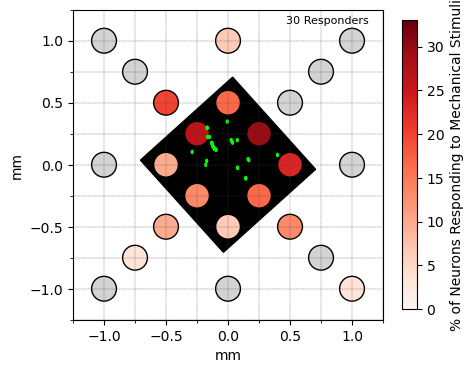

# of Responses at each location: 
[2.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 5.0, 0.0, 7.0, 4.0, 2.0, 3.0, 3.0, 6.0, 8.0, 9.0, 5.0, 4.0]


In [36]:
allData = []
allROIs = []

# loop through all neurons in the datasheet
for item in cellDataList:
    
    # sort for responding cells only
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        
        # get locations of stimuli that caused a response in this cell
        data = item['25s Mech Stim Window Binary'][1:-1]
        # get ROI coordinate of this cell
        data2 = item['ROI Coords'][1:-1]

        #To assist in cleaning the data into times and intensities
        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        
        allData.append(dataList)
        allROIs.append(cellBody)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](3*popData[i]/len(allData)))
        ax.add_artist(c)
        
for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=33), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.8, 1.2, str(len(allData)) + ' Responders', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

## MYP ONLY Population Mechanical Response Grid (Binary during 25s Stimulus Window)

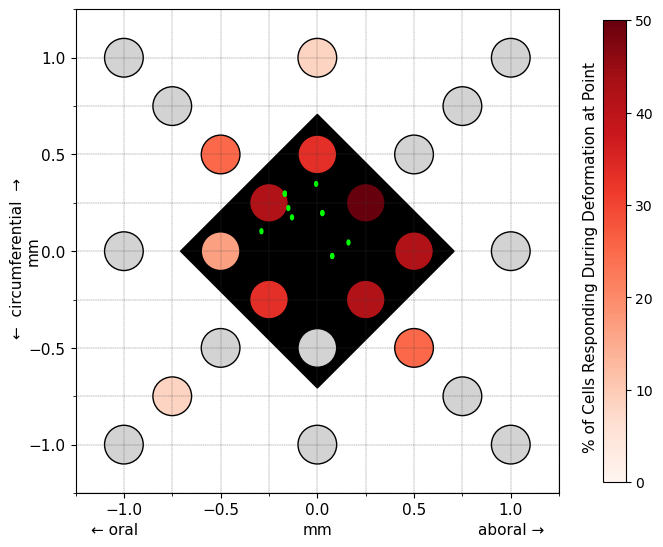

# of Responses at each location: 
[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 4.0, 0.0, 5.0, 3.0, 0.0, 0.0, 2.0, 3.0, 5.0, 6.0, 5.0, 4.0]
# of MYP responders:  12


In [9]:
allData = []
allROIs = []

for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "MYP":
            data = item['25s Mech Stim Window Binary'][1:-1]
            data2 = item['ROI Coords'][1:-1]

            split_char1 = ","

            dataList = []
            cellBody = []
            nextValue = data.split(split_char1)
            nextValue2 = data2.split(split_char1)
            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                dataList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellBody.append(float(nextValue2[i]))

            allData.append(dataList)
            allROIs.append(cellBody)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(8,8))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 45, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](2*popData[i]/len(allData)))
        ax.add_artist(c)
        
for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=50), cmap= 'Reds'), ax = ax, \
             shrink = 0.75, pad=0.07)   

#ax.set_xlabel('mm', fontsize = 11)    
#ax.set_ylabel('mm', fontsize = 11)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 11)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

ax.text(-1.05, -1.4, "\u2190 oral", ha='center', va='top', color='black', size = 11)
ax.text(1, -1.4, "aboral \u2192", ha='center', va='top', color='black', size = 11)
ax.text(0, -1.4, "mm", ha='center', va='top', color='black', size = 11)
ax.text(-1.55, 0.38, "\u2190  circumferential  \u2192", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
ax.text(-1.47, 0.08, "mm", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
ax.text(1.41, 0.98, '% of Cells Responding During Deformation at Point', ha='center', va='top', color='black', size = 11, rotation = 'vertical')

#ax.text(0, 1.2, str(len(allData)) + ' MYP Quiescent Responders', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

print("# of MYP responders: ", len(allData))

## SMP ONLY Population Mechanical Response Grid (Binary during 25s Stimulus Window)

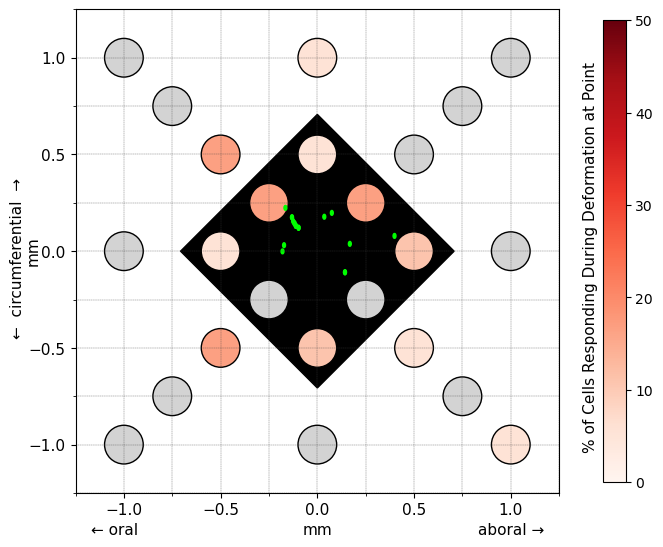

# of Responses at each location: 
[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 2.0, 1.0, 2.0, 3.0, 1.0, 3.0, 3.0, 3.0, 0.0, 0.0]
# of SMP responders:  18


In [10]:
allData = []
allROIs = []

for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "SMP":
            data = item['25s Mech Stim Window Binary'][1:-1]
            data2 = item['ROI Coords'][1:-1]

            split_char1 = ","

            dataList = []
            cellBody = []
            nextValue = data.split(split_char1)
            nextValue2 = data2.split(split_char1)
            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                dataList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellBody.append(float(nextValue2[i]))

            allData.append(dataList)
            allROIs.append(cellBody)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(8,8))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 45, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](2*popData[i]/len(allData)))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

#fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=50), cmap= 'Reds'), ax = ax, \
             #shrink = 0.75).set_label(label='% of Cells Responding During Deformation at Point', size=11)
fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=50), cmap= 'Reds'), ax = ax, \
             shrink = 0.75, pad=0.07)   
    
#ax.set_xlabel('mm', fontsize = 11)    
#ax.set_ylabel('mm', fontsize = 11)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 11)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

ax.text(-1.05, -1.4, "\u2190 oral", ha='center', va='top', color='black', size = 11)
ax.text(1, -1.4, "aboral \u2192", ha='center', va='top', color='black', size = 11)
ax.text(0, -1.4, "mm", ha='center', va='top', color='black', size = 11)
ax.text(-1.55, 0.38, "\u2190  circumferential  \u2192", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
ax.text(-1.47, 0.08, "mm", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
ax.text(1.41, 0.98, '% of Cells Responding During Deformation at Point', ha='center', va='top', color='black', size = 11, rotation = 'vertical')


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

print("# of SMP responders: ", len(allData))

## Only Responder Binary Plots -- red = response to stimuli at this location

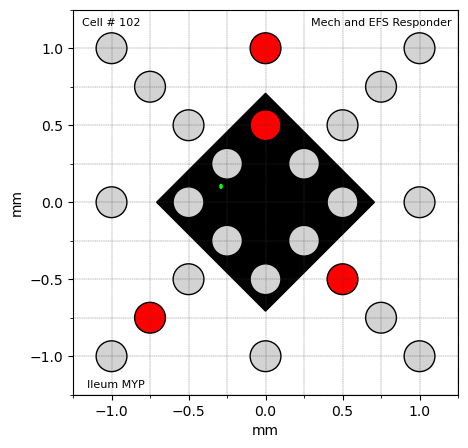

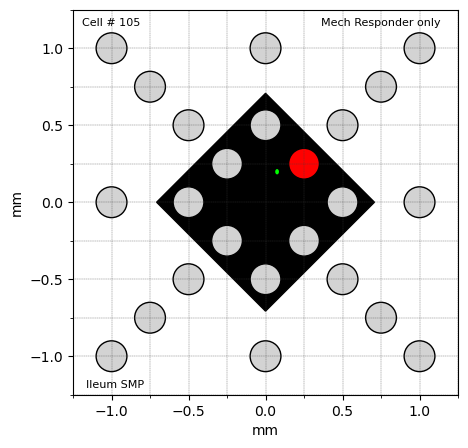

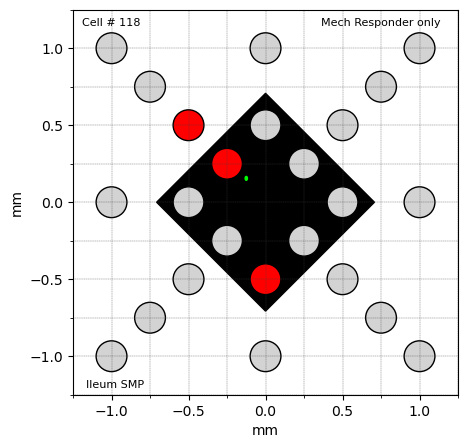

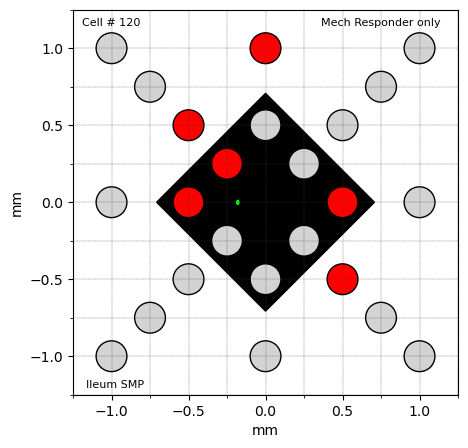

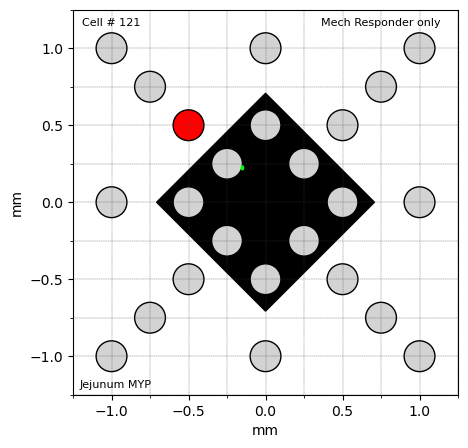

...

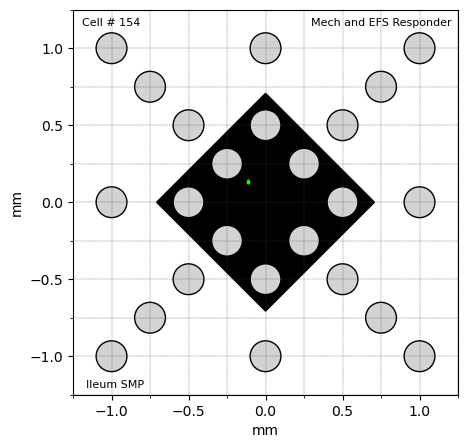

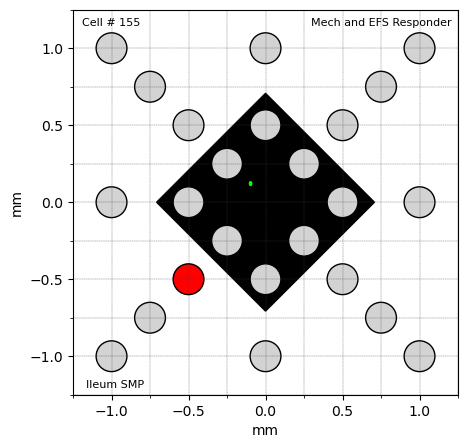

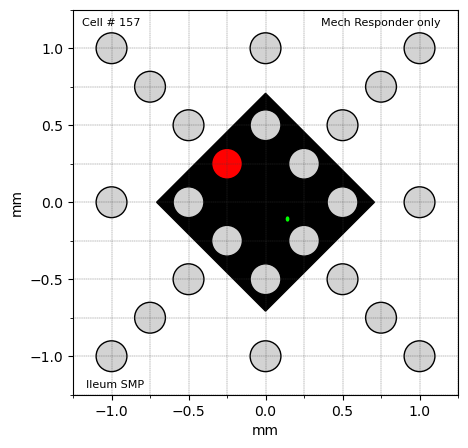

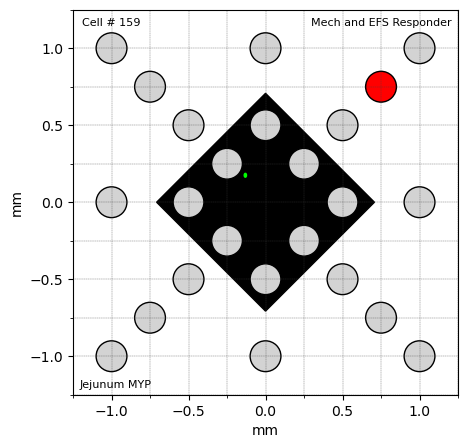

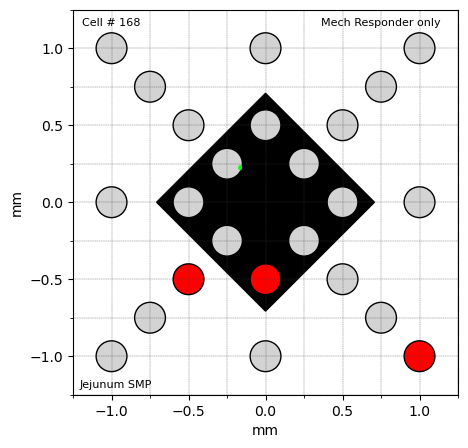

In [40]:
cellNum = 0

for item in cellDataList:
    
    cellNum = cellNum + 1
    
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['20s Post Stim Window Binary'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        dataList2 = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            dataList2.append(float(nextValue3[i]))

        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)


        fig, ax = plt.subplots(figsize=(5,5))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 45, rotation_point='center')
        ax.add_artist(r)

        for i in range(len(stimLocations)):
            if dataList[i] == 0 and dataList2[i] == 0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)
            else:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='red')
                ax.add_artist(c)

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        ax.set_xlabel('mm', fontsize = 10)    
        ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 8)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 8)

        
        ax.text(0.75, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 8)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

        plt.show()

# Spontaneous Cell Plots

## Population Mechanical Response Grid (Binary during 25s Stimulus Window)

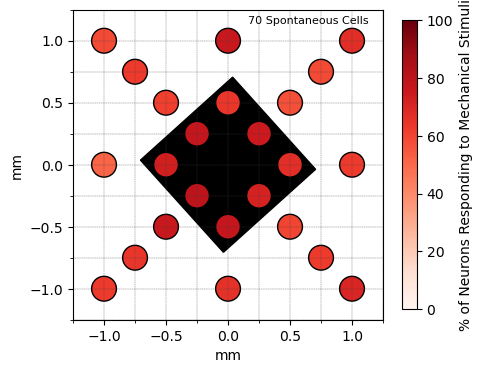

# of Responses at each location: [53.0, 47.0, 44.0, 49.0, 46.0, 44.0, 36.0, 41.0, 44.0, 41.0, 44.0, 45.0, 45.0, 40.0, 47.0, 42.0, 54.0, 53.0, 51.0, 43.0, 54.0, 52.0, 50.0, 56.0]


In [14]:
allData = []


for item in cellDataList:
    if item['Responder?'] == "Spontaneous Cell":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        
        allData.append(dataList)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)


for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](popData[i]/len(allData)))
        ax.add_artist(c)

# Display Cell
#cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
#ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=100), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.65, 1.2, str(len(allData)) + ' Spontaneous Cells', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: " + str(popData))

## Only Spontaneous Binary Plots (Binary during 25s Stimulus Window)

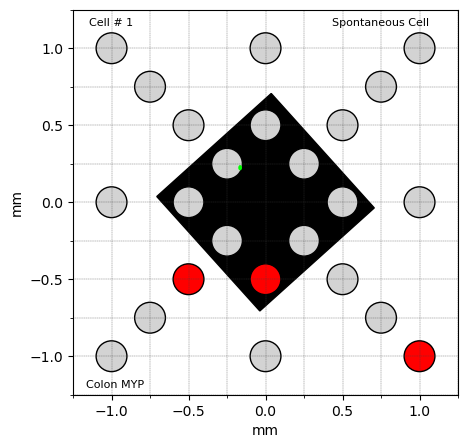

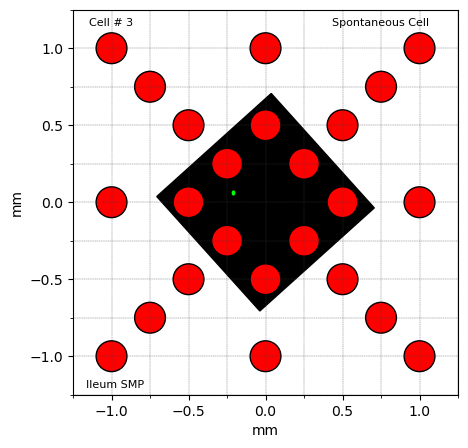

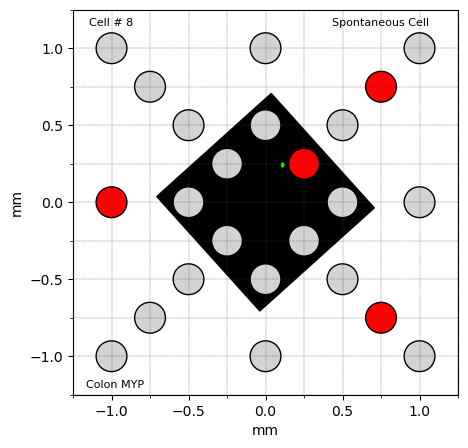

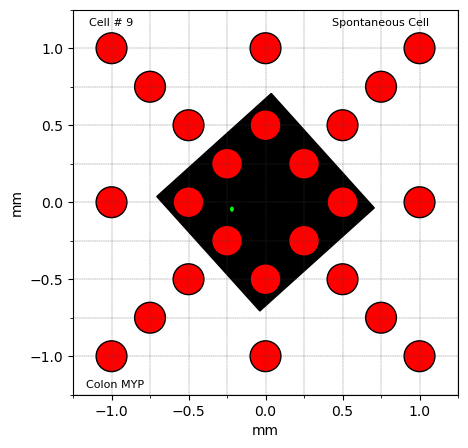

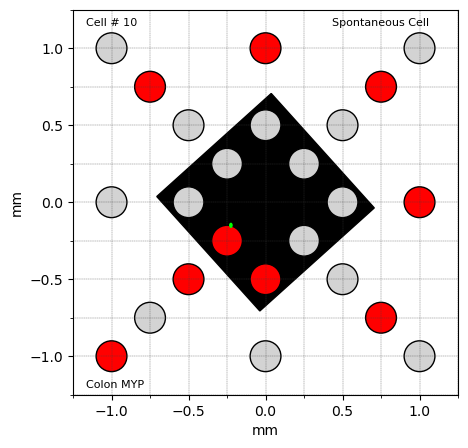

...

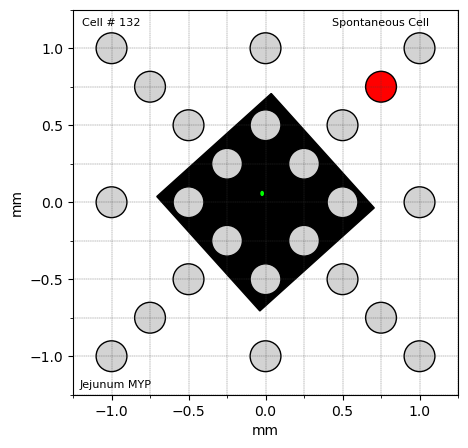

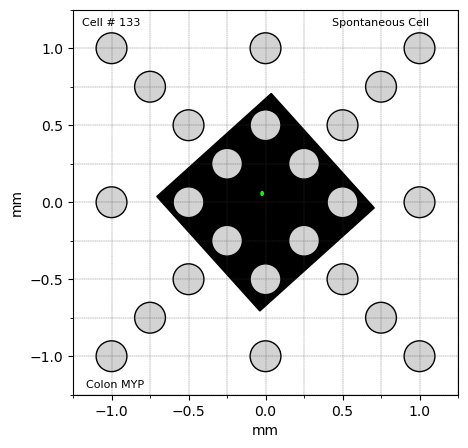

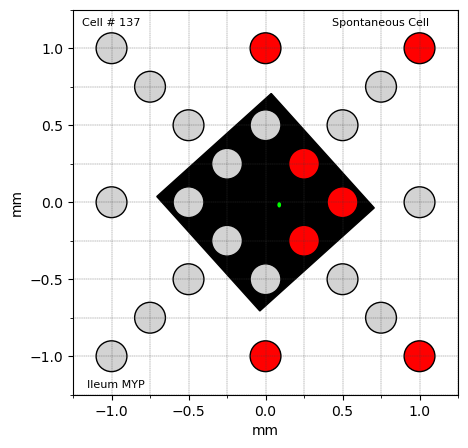

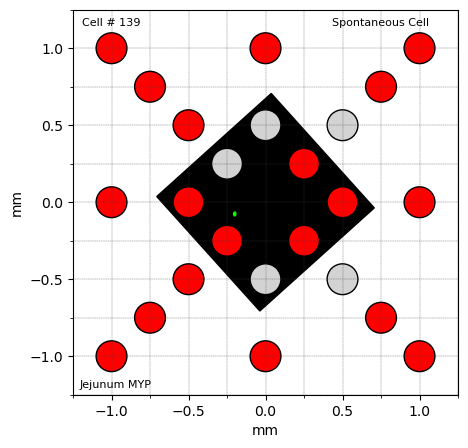

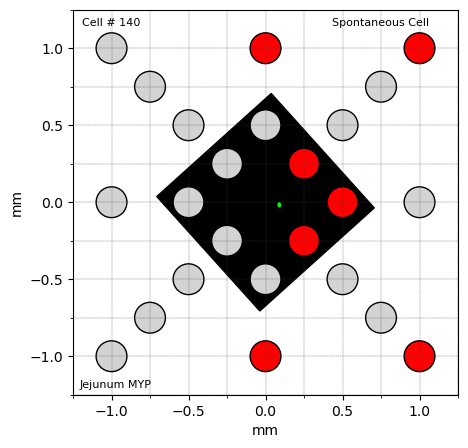

In [15]:
cellNum = 0

for item in cellDataList:
    cellNum = cellNum + 1
    
    if item['Responder?'] == "Spontaneous Cell":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))

        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)


        fig, ax = plt.subplots(figsize=(5,5))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
        ax.add_artist(r)

        for i in range(len(stimLocations)):
            if dataList[i] == 0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)
            else:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='red')
                ax.add_artist(c)

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        ax.set_xlabel('mm', fontsize = 10)    
        ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 8)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 8)

        ax.text(0.75, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 8)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

        plt.show()

## Population Mechanical Response Grid (Binary during Post-Stimulation Window)

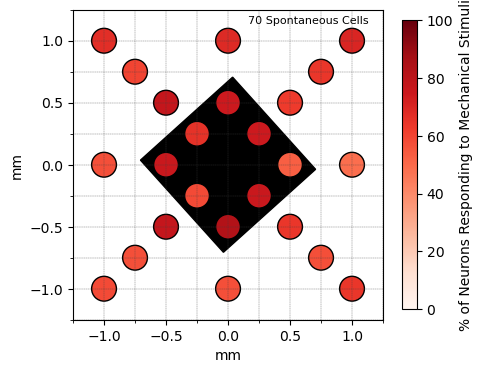

# of Responses at each location: [48.0, 49.0, 34.0, 45.0, 40.0, 41.0, 40.0, 47.0, 42.0, 45.0, 40.0, 40.0, 52.0, 44.0, 37.0, 45.0, 58.0, 54.0, 53.0, 54.0, 46.0, 52.0, 53.0, 41.0]


In [16]:
allData = []


for item in cellDataList:
    if item['Responder?'] == "Spontaneous Cell":
        data = item['20s Post Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        
        allData.append(dataList)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](popData[i]/len(allData)))
        ax.add_artist(c)

# Display Cell
#cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
#ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=100), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.65, 1.2, str(len(allData)) + ' Spontaneous Cells', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: " + str(popData))

## Only Spontaneous Binary Plots (Binary during Post-Stimulation Window)

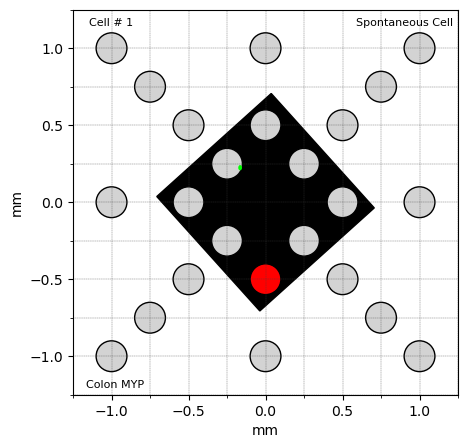

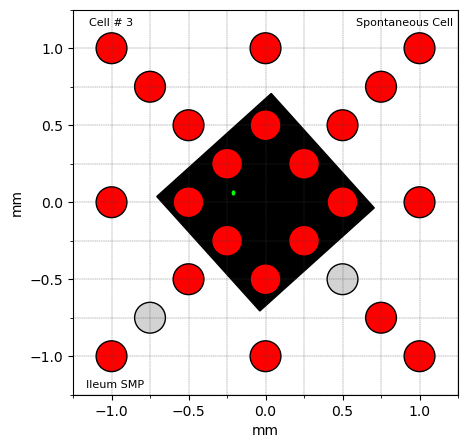

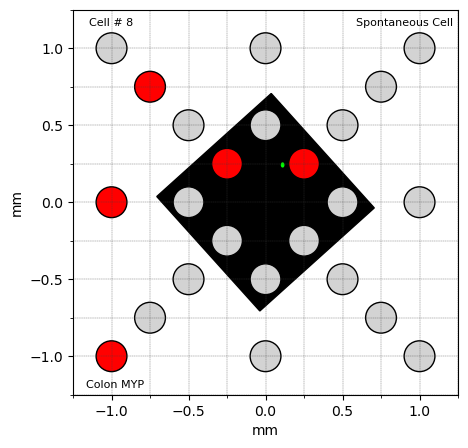

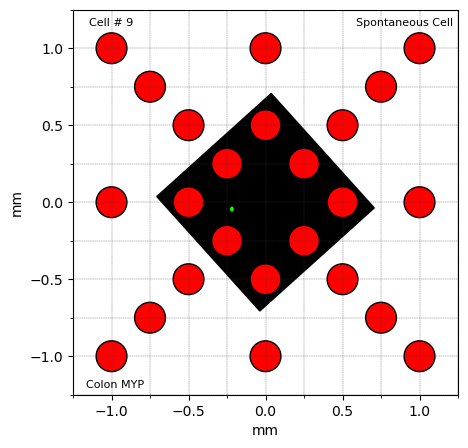

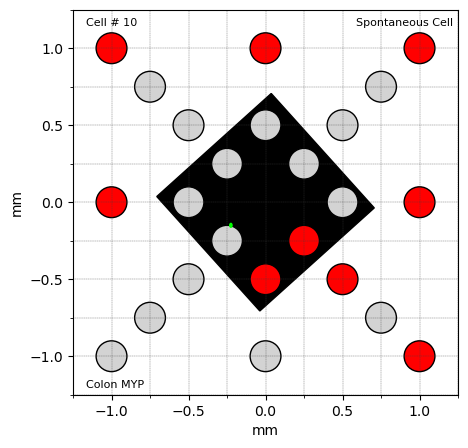

...

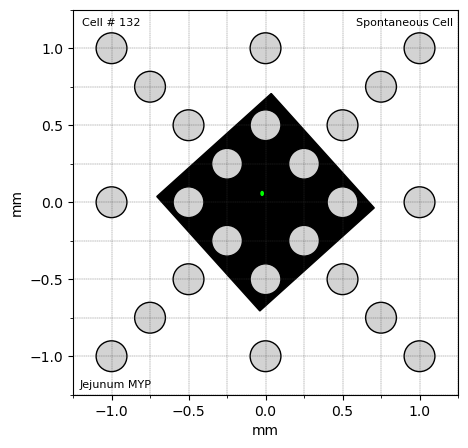

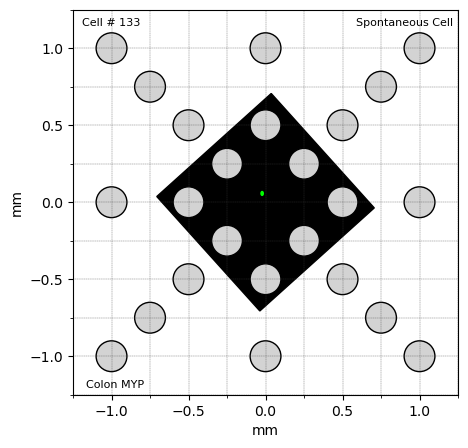

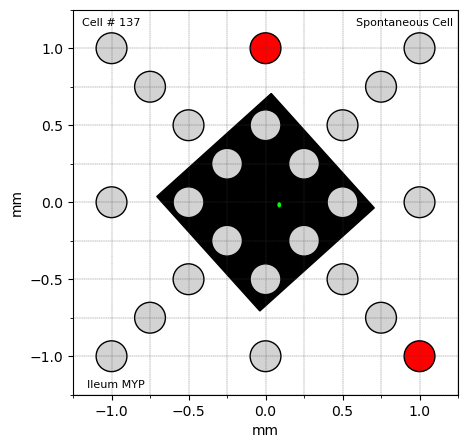

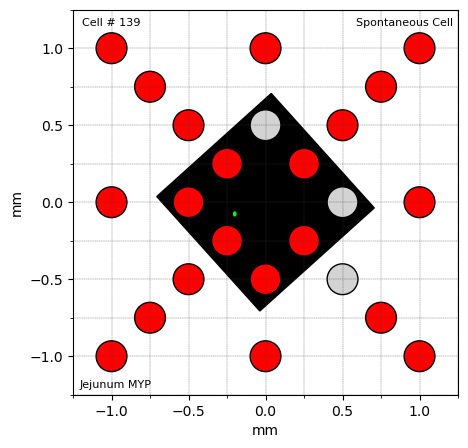

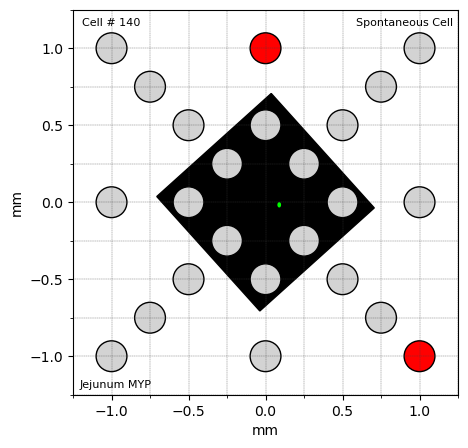

In [17]:
cellNum = 0

for item in cellDataList:
    cellNum = cellNum + 1
        
    if item['Responder?'] == "Spontaneous Cell":
        data = item['20s Post Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))

        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)


        fig, ax = plt.subplots(figsize=(5,5))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
        ax.add_artist(r)

        for i in range(len(stimLocations)):
            if dataList[i] == 0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)
            else:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='red')
                ax.add_artist(c)

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        ax.set_xlabel('mm', fontsize = 10)    
        ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 8)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 8)

        ax.text(0.9, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 8)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

        plt.show()

# EFS Responses Only

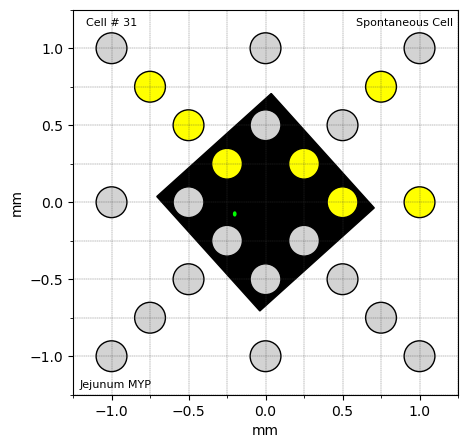

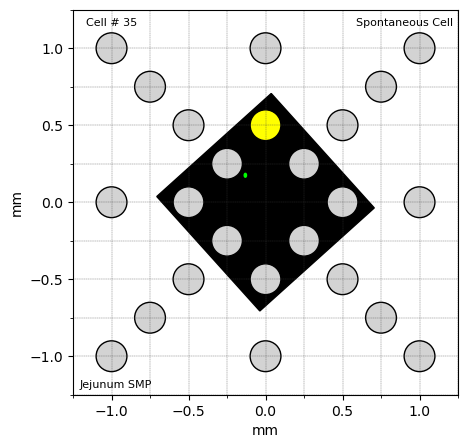

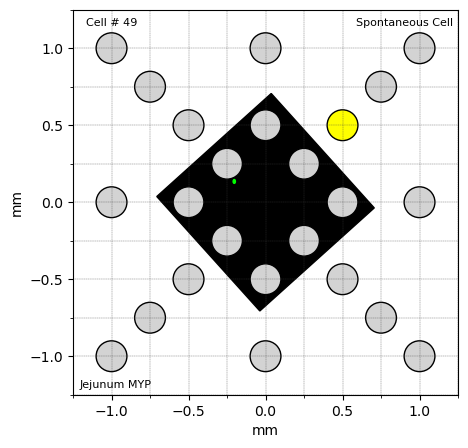

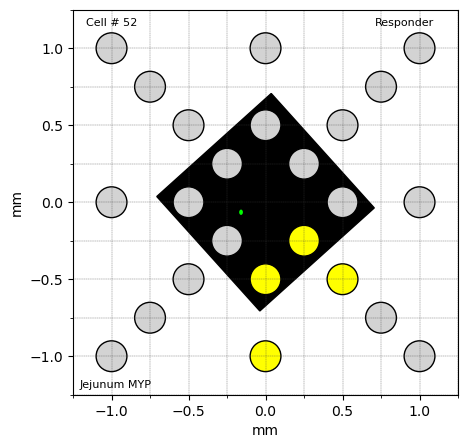

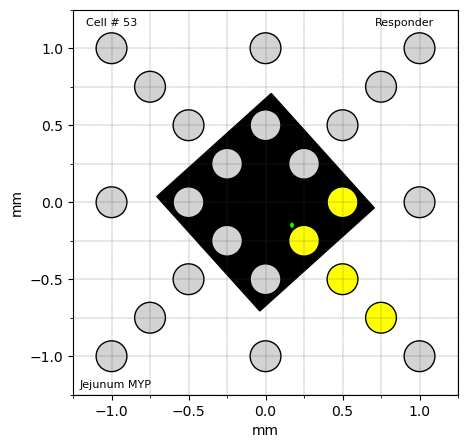

...

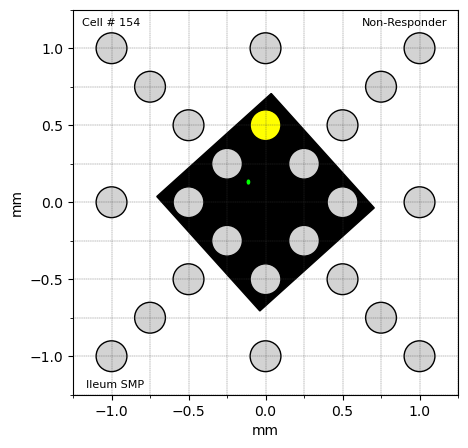

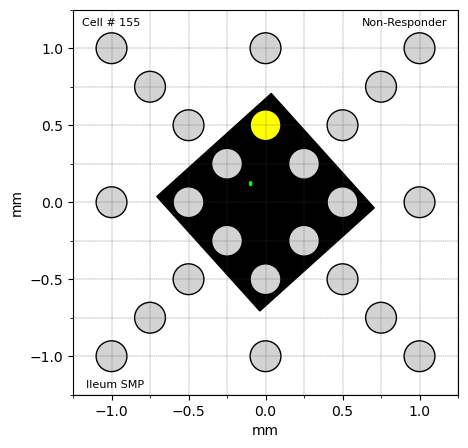

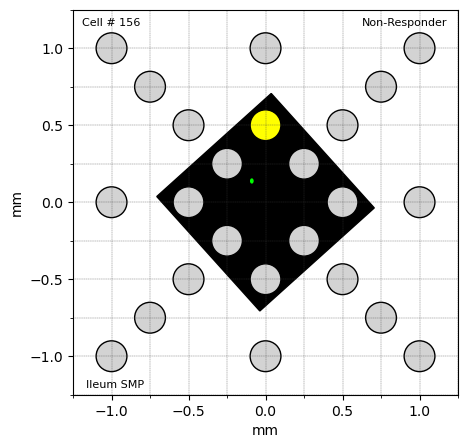

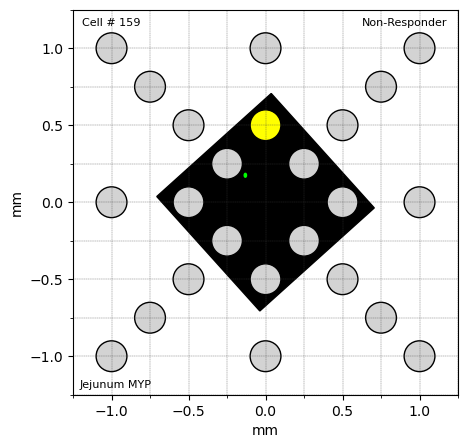

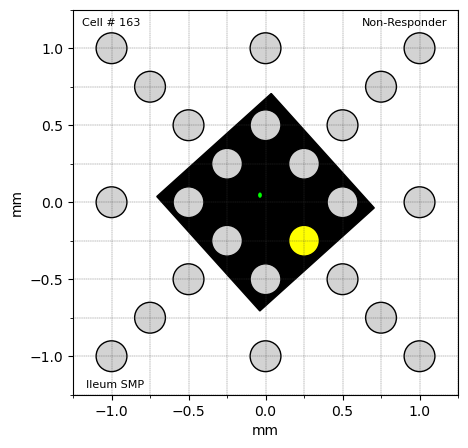

In [18]:
cellNum = 0

for item in cellDataList:
    cellNum = cellNum + 1
        
    if "1" in item['EFS Binary']:
        data = item['EFS Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]

        split_char1 = ","

        dataList = []
        cellBody = []
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            dataList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))

        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)
        
        #print(item['Step 1 Latency to Spike in Stim Window'])

        fig, ax = plt.subplots(figsize=(5,5))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
        ax.add_artist(r)

        for i in range(len(stimLocations)):
            if dataList[i] == 0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)
            else:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='yellow')
                ax.add_artist(c)

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        ax.set_xlabel('mm', fontsize = 10)    
        ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 8)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 8)

        if item['Responder?'] == "Spontaneous Cell":
            ax.text(0.9, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 8)
        elif item['Responder?'] == "Yes":
            ax.text(0.9, 1.2, 'Responder', ha='center', va='top', color='black', size = 8)
        else:
            ax.text(0.9, 1.2, 'Non-Responder', ha='center', va='top', color='black', size = 8)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

        plt.show()

# Plotting all of the Latencies for each responding spot

Here are all of the latencies:
[0.24, 0.32, 0.18, 0.24, 0.2, 23.08, 4.63, 0.18, 4.17, 0.24, 6.51, 4.47, 3.95, 0.0, 0.16, 0.16, 0.32, 0.18, 0.16, 0.32, 0.18, 19.17, 19.9, 19.76, 19.31, 19.15, 19.02, 18.86, 18.72, 18.57, 19.9, 19.76, 19.31, 19.15, 19.02, 18.72, 18.57, 18.57, 0.18, 25.1, 0.14, 0.18, 25.1, 0.14, 0.24, 0.18, 0.16, 0.16, 0.2, 0.46, 0.16, 25.08, 0.16, 31.77, 0.16, 32.18, 0.18, 28.79, 11.31, 0.0, 31.39, 28.79, 11.31, 0.0, 28.79, 16.44, 10.37, 13.39]
MYP latencies:
[0.24, 0.32, 0.18, 0.24, 0.16, 0.16, 0.32, 0.18, 0.16, 0.32, 0.18, 19.9, 19.76, 19.31, 19.15, 19.02, 18.86, 18.72, 18.57, 19.9, 19.76, 19.31, 19.15, 19.02, 18.72, 18.57, 18.57, 0.18, 25.1, 0.14, 0.18, 25.1, 0.14, 0.24, 0.18, 0.16, 0.16, 0.2, 0.46, 28.79]
SMP latencies:
[0.2, 23.08, 4.63, 0.18, 4.17, 0.24, 6.51, 4.47, 3.95, 0.0, 19.17, 0.16, 25.08, 0.16, 31.77, 0.16, 32.18, 0.18, 28.79, 11.31, 0.0, 31.39, 28.79, 11.31, 0.0, 16.44, 10.37, 13.39]
Here are all of the # of spikes/spot:
[2, 1, 1, 1, 3, 1, 3, 12, 5, 5, 2, 3

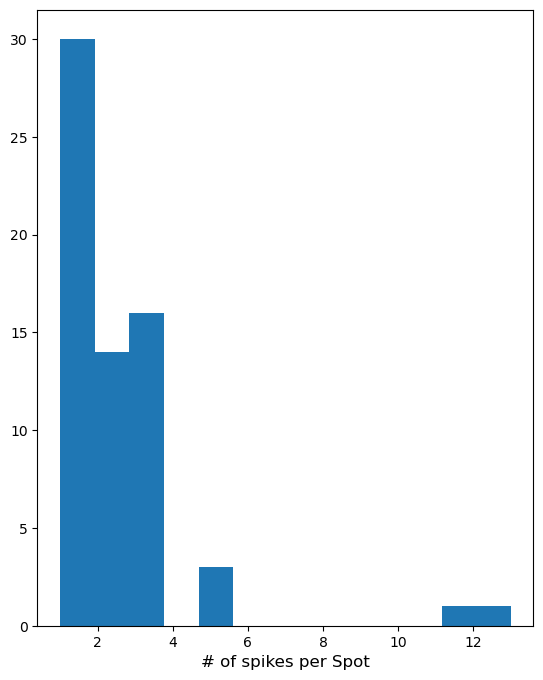

[30. 14. 16.  0.  3.  0.  0.  0.  0.  0.  0.  1.  1.]
Number of Spots: 68

The average Latency is: 10.262647058823529


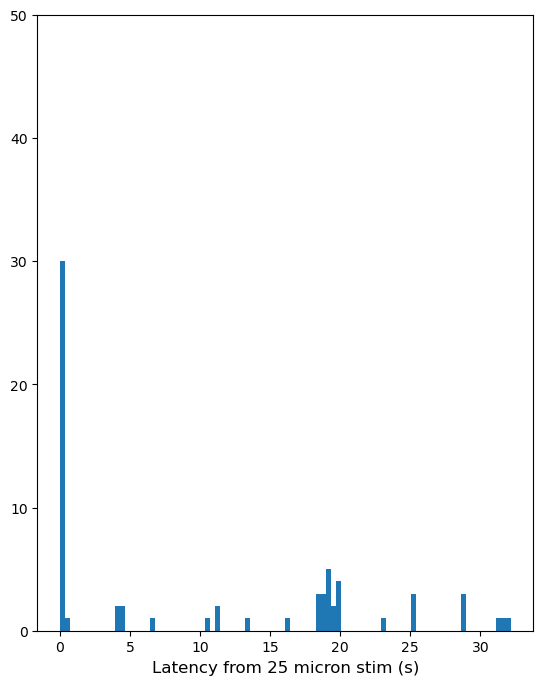

[30.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  2.  2.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  2.  0.  0.  0.  0.
  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  3.  3.  5.
  2.  4.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  3.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  1.  1.  1.]


In [45]:
from statistics import mean 

allLatencies = []
MYPLatencies = []
SMPLatencies = []
allAvgFreq = []
MYPAvgFreq = []
SMPAvgFreq = []


for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":    
        cellBin = item['25s Mech Stim Window Binary'][1:-1]
        cellLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
        cellBin2 = item['20s Post Stim Window Binary'][1:-1]
        cellLat2 = item['Step 1 Latency to Spike in Post Stim Window'][1:-1]
        cellAvg = item['Avg Freq Full 45s'][1:-1]
        
        split_char1 = ","

        cellBinList = []
        cellLatList = []
        cellBin2List = []
        cellLat2List = []
        cellAvgList = []
        nextValue = cellBin.split(split_char1)
        nextValue2 = cellLat.split(split_char1)
        nextValue3 = cellBin2.split(split_char1)
        nextValue4 = cellLat2.split(split_char1)
        nextValue5 = cellAvg.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            cellBinList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellLatList.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            cellBin2List.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            cellLat2List.append(float(nextValue4[i]))
        for i in range(len(nextValue5)):
            cellAvgList.append(float(nextValue5[i]))
        
        for y in range(24):
            if cellBinList[y] == 1:
                allLatencies.append(cellLatList[y])
                allAvgFreq.append(cellAvgList[y])
                if item['Plexus'] == "MYP":
                    MYPLatencies.append(cellLatList[y])
                    MYPAvgFreq.append(cellAvgList[y])
                elif item['Plexus'] == "SMP":
                    SMPLatencies.append(cellLatList[y])
                    SMPAvgFreq.append(cellAvgList[y])
                    
            elif cellBin2List[y] == 1:
                allLatencies.append(cellLat2List[y])
                allAvgFreq.append(cellAvgList[y])
                if item['Plexus'] == "MYP":
                    MYPLatencies.append(cellLat2List[y])
                    MYPAvgFreq.append(cellAvgList[y])
                elif item['Plexus'] == "SMP":
                    SMPLatencies.append(cellLat2List[y])
                    SMPAvgFreq.append(cellAvgList[y])

print("Here are all of the latencies:")
print(allLatencies)
print("MYP latencies:")
print(MYPLatencies)
print("SMP latencies:")
print(SMPLatencies)


print("Here are all of the # of spikes/spot:")
spikesPerSpot = []
for f in allAvgFreq:
    if f != 0.0:
        spikesPerSpot.append(round(f * 45))
print(spikesPerSpot)

print("MYP # of spikes/spot:")
MYPspikesPerSpot = []
for f in MYPAvgFreq:
    if f != 0.0:
        MYPspikesPerSpot.append(round(f * 45))
print(MYPspikesPerSpot)

print("SMP # of spikes/spot:")
SMPspikesPerSpot = []
for f in SMPAvgFreq:
    if f != 0.0:
        SMPspikesPerSpot.append(round(f * 45))
print(SMPspikesPerSpot)


#Creates intensity vs time plot, setting size of plot
allLats = plt.figure()
allLats.set_figheight(8)
counts = plt.hist(spikesPerSpot, bins = 13)

plt.xlabel('# of spikes per Spot', fontdict = {'fontsize' : 12})

plt.show()

print(counts[0])


LatAvg = mean(allLatencies)
print("Number of Spots:", len(allLatencies))
print("\n" + "The average Latency is: " + str(LatAvg))

#Creates intensity vs time plot, setting size of plot
allLats = plt.figure()
allLats.set_figheight(8)
counts = plt.hist(allLatencies, bins = 90)

plt.xlabel('Latency from 25 micron stim (s)', fontdict = {'fontsize' : 12})
plt.ylim(0,50)
plt.show()

print(counts[0])

# For cells w/ latency < 0.5s -- MYP Cells

Here are all of the latencies:
[0.24, 0.32, 0.18, 0.24, 0.16, 0.16, 0.32, 0.18, 0.16, 0.32, 0.18, 0.18, 0.14, 0.18, 0.14, 0.24, 0.18, 0.16, 0.16, 0.2, 0.46]
Here are all of the Inst Freq:
[0.05, 0.0, 0.0, 0.0, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.0, 0.04, 0.04, 0.04, 0.04, 0.04]
Here are all of the Avg Freq:
[0.08, 0.04, 0.04, 0.04, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.08, 0.04, 0.08, 0.08, 0.08, 0.08, 0.08]
Here are all of the Post Bin:
[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0]
Here are the avg freq of the ones with post stim responses:
[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05]
Here is the plexus for these cells:
['MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP']
21


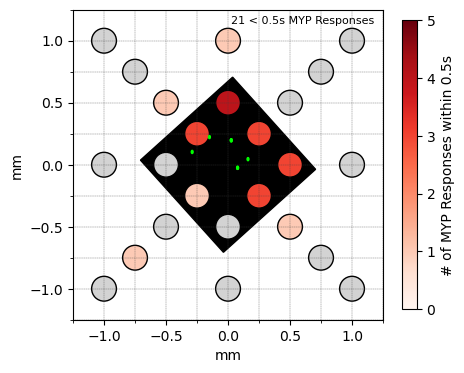

# of Responses at each location: 
[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 4, 0, 3, 1, 0, 0, 0, 1, 3, 3, 3, 1]


In [46]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allPostAF = []
PlexusList = []
allData = []
allROIs = []


for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "MYP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
            data3 = item['Max Inst Freq 25s Mech Stim Window'][1:-1]
            data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data6 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            AvgFPost = []
            cellBody = []

            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue6 = data6.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))
            for i in range(len(nextValue6)):
                AvgFPost.append(float(nextValue6[i]))

            cellData = []

            for y in range(24):
                if cellBinList[y] == 1 and cellLatList[y] <=0.5:
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                    if PostBin[y] == 1.0:
                        allPostAF.append(AvgFPost[y])

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)
     
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](popData[i]/5))
        ax.add_artist(c)   
        
for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax= 5), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='# of MYP Responses within 0.5s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.6, 1.2, str(len(allLatencies)) + ' < 0.5s MYP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# For cells w/ latency < 0.5s -- SMP Cells

Here are all of the latencies:
[0.2, 0.18, 0.24, 0.0, 0.16, 0.16, 0.16, 0.18]
Here are all of the Inst Freq:
[0.04, 5.0, 3.57, 0.0, 0.04, 0.04, 0.04, 0.04]
Here are all of the Avg Freq:
[0.08, 0.48, 0.2, 0.0, 0.08, 0.08, 0.08, 0.08]
Here are all of the Post Bin:
[1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0]
Here are the avg freq of the ones with post stim responses:
[0.05, 0.05, 0.05]
Here is the plexus for these cells:
['SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP']
8


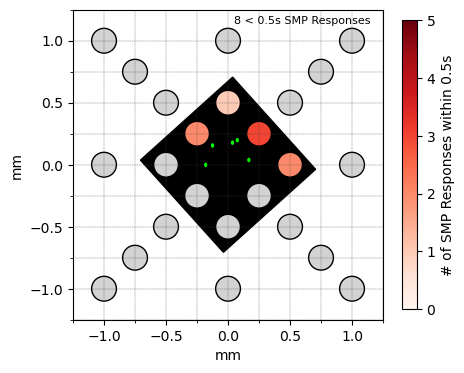

# of Responses at each location: 
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 2, 3, 0, 0]


In [22]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allPostAF = []
PlexusList = []
allData = []
allROIs = []



for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "SMP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
            data3 = item['Max Inst Freq 25s Mech Stim Window'][1:-1]
            data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data6 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            AvgFPost = []
            cellBody = []

            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue6 = data6.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))
            for i in range(len(nextValue6)):
                AvgFPost.append(float(nextValue6[i]))

            cellData = []

            for y in range(24):
                if cellBinList[y] == 1 and cellLatList[y] <=0.5:
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                    if PostBin[y] == 1.0:
                        allPostAF.append(AvgFPost[y])

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)

    
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds'](popData[i]/5))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=5), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='# of SMP Responses within 0.5s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.6, 1.2, str(len(allLatencies)) + ' < 0.5s SMP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# For cells w/ latency 25s > x > 0.5s -- MYP cells

Here are all of the latencies:
[19.9, 19.76, 19.31, 19.15, 19.02, 18.86, 18.72, 18.57, 19.9, 19.76, 19.31, 19.15, 19.02, 18.72, 18.57, 18.57, 25.1, 25.1]
Here are all of the Inst Freq:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Here are all of the Avg Freq:
[0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04]
Here are all of the Post Bin:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Here are the avg freq of the ones with post stim responses:
[]
Here is the plexus for these cells:
['MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP', 'MYP']
18


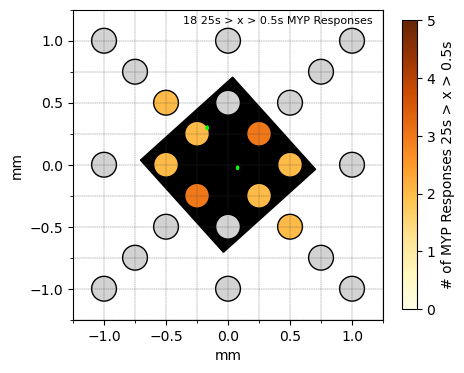

# of Responses at each location: 
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 3, 2, 3]


In [47]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allPostAF = []
PlexusList = []
allData = []
allROIs = []
        
    
for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "MYP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
            data3 = item['Max Inst Freq 25s Mech Stim Window'][1:-1]
            data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data6 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            AvgFPost = []
            cellBody = []

            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue6 = data6.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))
            for i in range(len(nextValue6)):
                AvgFPost.append(float(nextValue6[i]))

            cellData = []

            for y in range(24):
                if cellBinList[y] == 1 and cellLatList[y] >0.5:
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                    if PostBin[y] == 1.0:
                        allPostAF.append(AvgFPost[y])

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)
        
     
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['YlOrBr'](popData[i]/5))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=5), cmap= 'YlOrBr'), ax = ax, \
             shrink = 0.75).set_label(label='# of MYP Responses 25s > x > 0.5s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.4, 1.2, str(len(allLatencies)) + ' 25s > x > 0.5s MYP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# For cells w/ latency 25s > x > 0.5s -- SMP cells

Here are all of the latencies:
[23.08, 4.63, 4.17, 6.51, 4.47, 3.95, 19.17, 25.08, 11.31, 11.31, 16.44, 10.37, 13.39]
Here are all of the Inst Freq:
[0.0, 0.85, 0.89, 1.92, 1.25, 2.63, 0.0, 0.0, 3.57, 3.57, 1.72, 0.0, 0.0]
Here are all of the Avg Freq:
[0.04, 0.12, 0.12, 0.08, 0.12, 0.12, 0.04, 0.04, 0.08, 0.08, 0.2, 0.04, 0.04]
Here are all of the Post Bin:
[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0]
Here are the avg freq of the ones with post stim responses:
[0.1, 0.05, 0.6, 0.05]
Here is the plexus for these cells:
['SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP']
13


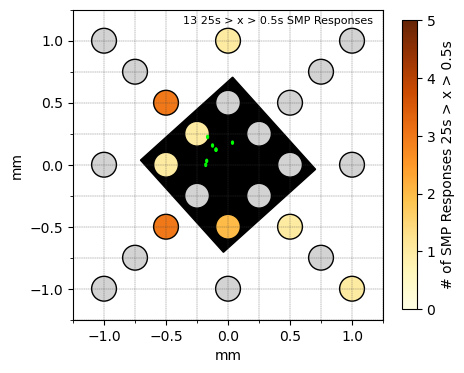

# of Responses at each location: 
[1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 3, 1, 3, 1, 0, 0, 0]


In [48]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allPostAF = []
PlexusList = []
allData = []
allROIs = []


        
for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "SMP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
            data3 = item['Max Inst Freq 25s Mech Stim Window'][1:-1]
            data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data6 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            AvgFPost = []
            cellBody = []

            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue6 = data6.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))
            for i in range(len(nextValue6)):
                AvgFPost.append(float(nextValue6[i]))


            cellData = []

            for y in range(24):
                if cellBinList[y] == 1 and cellLatList[y] >0.5:
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                    if PostBin[y] == 1.0:
                        allPostAF.append(AvgFPost[y])

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)
        
     
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['YlOrBr'](popData[i]/5))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=5), cmap= 'YlOrBr'), ax = ax, \
             shrink = 0.75).set_label(label='# of SMP Responses 25s > x > 0.5s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.4, 1.2, str(len(allLatencies)) + ' 25s > x > 0.5s SMP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# For cells w/ latency > 25s -- MYP cells

Here are all of the latencies:
[28.79]
Here are all of the Inst Freq:
[0.0]
Here are all of the Avg Freq:
[0.05]
Here are all of the Post Bin:
[1.0]
Here are the avg freq of the ones with post stim responses:
[0.1, 0.05, 0.6, 0.05]
Here is the plexus for these cells:
['MYP']
1


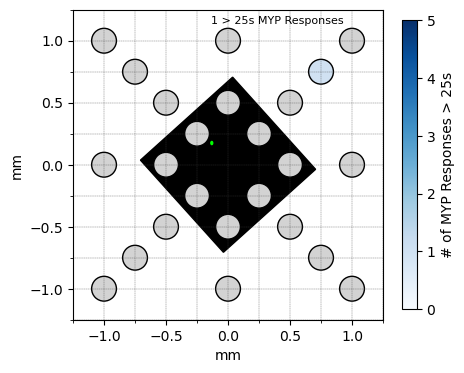

# of Responses at each location: 
[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [49]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allMechBin = []
PlexusList = []
allData = []
allROIs = []
        

    
for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "MYP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Post Stim Window'][1:-1]
            data3 = item['Max Inst Freq Post Stim Window'][1:-1]
            data4 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            cellBody = []


            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))

            cellData = []

            for y in range(24):
                if cellBinList[y] == 0 and PostBin[y] == 1.0:
                    allMechBin.append(cellBinList[y])
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)
        
     
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Blues'](popData[i]/5))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=5), cmap= 'Blues'), ax = ax, \
             shrink = 0.75).set_label(label='# of MYP Responses > 25s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.4, 1.2, str(len(allLatencies)) + ' > 25s MYP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# For cells w/ latency > 25s -- SMP cells

Here are all of the latencies:
[31.77, 32.18, 28.79, 0.0, 31.39, 28.79, 0.0]
Here are all of the Inst Freq:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Here are all of the Avg Freq:
[0.05, 0.05, 0.05, 0.0, 0.05, 0.05, 0.0]
Here are all of the Post Bin:
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
Here are the avg freq of the ones with post stim responses:
[0.1, 0.05, 0.6, 0.05]
Here is the plexus for these cells:
['SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP', 'SMP']
7


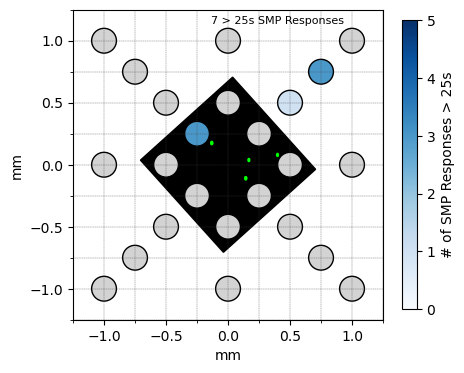

# of Responses at each location: 
[0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]


In [50]:
from statistics import mean 
allLatencies = []
allInstFreq = []
allAvgFreq = []
allPostBin = []
allMechBin = []
PlexusList = []
allData = []
allROIs = []


for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        if item['Plexus'] == "SMP":
            cellBin = item['25s Mech Stim Window Binary'][1:-1]
            cellLat = item['Step 1 Latency to Spike in Post Stim Window'][1:-1]
            data3 = item['Max Inst Freq Post Stim Window'][1:-1]
            data4 = item['Avg Freq 20s Post Stim Window'][1:-1]
            data5 = item['20s Post Stim Window Binary'][1:-1]
            data7 = item['ROI Coords'][1:-1]

            split_char1 = ","

            cellBinList = []
            cellLatList = []
            InstFreq = []
            AvgFreq = []
            PostBin = []
            cellBody = []


            nextValue = cellBin.split(split_char1)
            nextValue2 = cellLat.split(split_char1)
            nextValue3 = data3.split(split_char1)
            nextValue4 = data4.split(split_char1)
            nextValue5 = data5.split(split_char1)
            nextValue7 = data7.split(split_char1)

            #The loop that cleans each file and adds intensity for each line into intensityList
            for i in range(len(nextValue)):
                cellBinList.append(float(nextValue[i]))
            for i in range(len(nextValue2)):
                cellLatList.append(float(nextValue2[i]))
            for i in range(len(nextValue3)):
                InstFreq.append(float(nextValue3[i]))
            for i in range(len(nextValue4)):
                AvgFreq.append(float(nextValue4[i]))
            for i in range(len(nextValue5)):
                PostBin.append(float(nextValue5[i]))

            cellData = []

            for y in range(24):
                if cellBinList[y] == 0 and PostBin[y] == 1.0:
                    allMechBin.append(cellBinList[y])
                    allLatencies.append(cellLatList[y])
                    allInstFreq.append(InstFreq[y])
                    allAvgFreq.append(AvgFreq[y])
                    allPostBin.append(PostBin[y])
                    PlexusList.append(item['Plexus'])
                    cellData.append(1)
                    if cellBody == []:
                        for i in range(len(nextValue7)):
                                cellBody.append(float(nextValue7[i]))

                else:
                    cellData.append(0)
            allData.append(cellData)
            if cellBody != []:
                allROIs.append(cellBody)
        
     
print("Here are all of the latencies:")
print(allLatencies)
print("Here are all of the Inst Freq:")
print(allInstFreq)
print("Here are all of the Avg Freq:")
print(allAvgFreq)
print("Here are all of the Post Bin:")
print(allPostBin)
print("Here are the avg freq of the ones with post stim responses:")
print(allPostAF)
print("Here is the plexus for these cells:")
print(PlexusList)
print(len(PlexusList))

# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)

for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Blues'](popData[i]/5))
        ax.add_artist(c)

for k in range(len(allROIs)):
# Display Cell
    cell = Ellipse((allROIs[k][0],allROIs[k][1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
    ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=5), cmap= 'Blues'), ax = ax, \
             shrink = 0.75).set_label(label='# of SMP Responses > 25s', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.4, 1.2, str(len(allLatencies)) + ' > 25s SMP Responses', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)


plt.show()

print("# of Responses at each location: ")
print(popData)

# Sorting Responses in Spontaneous Cells

## All Spontaneous Cells
## And # of Spots per Spontaneous Cell (broken down by MYP and SMP)

All Spontaneous Cells


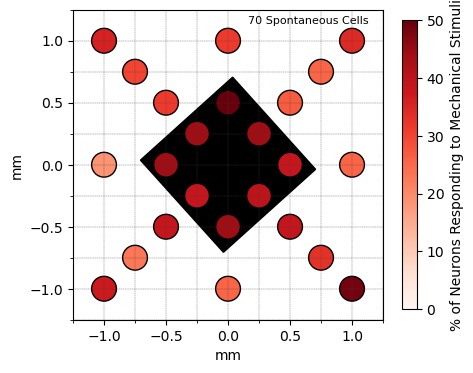

# of Responses at each location: [22, 24, 18, 34, 18, 26, 13, 25, 21, 18, 23, 16, 45, 19, 27, 27, 31, 27, 31, 22, 31, 31, 28, 27]
# of Spots per Spontaneous cells:  [2, 13, 2, 9, 3, 14, 2, 5, 15, 14, 1, 6, 10, 11, 6, 10, 10, 10, 11, 14, 14, 11, 9, 6, 7, 13, 10, 7, 13, 12, 13, 12, 12, 10, 9, 7, 14, 13, 11, 10, 6, 5, 13, 14, 14, 10, 5, 15, 5, 5, 9, 4, 2, 2, 4, 11, 10, 11, 11, 10, 13, 9, 5, 5, 6, 1, 0, 5, 8, 5]
# of Spots per MYP Spontaneous cells:  [2, 2, 9, 3, 14, 2, 5, 15, 14, 1, 6, 10, 11, 6, 10, 10, 11, 14, 14, 11, 9, 6, 13, 12, 13, 12, 12, 10, 9, 7, 14, 13, 11, 10, 5, 13, 14, 14, 10, 5, 15, 5, 2, 10, 11, 9, 5, 5, 6, 1, 0, 5, 8, 5]
# of Spots per SMP Spontaneous cells:  [13, 10, 7, 13, 10, 7, 6, 5, 9, 4, 2, 4, 11, 11, 10, 13]
Latency to Max Inst Freq of Spontaneous Responders:  [18.66, 25.02, 10.31, 25.2, 13.93, 7.08, 26.33, 19.99, 0.9, 29.07, 33.68, 12.01, 14.24, 25.64, 0.04, 1.62, 0.18, 25.26, 14.61, 8.72, 33.92, 25.06, 0.04, 25.29, 0.32, 21.48, 21.3, 24.56, 3.89, 20.51, 21.83, 14.

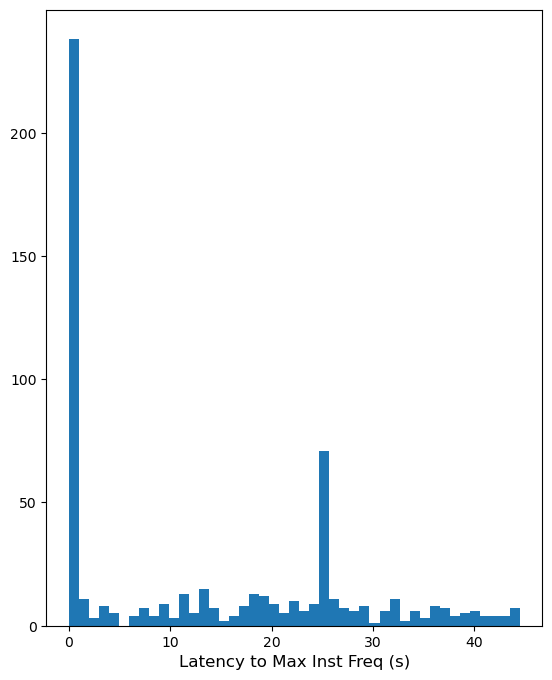

In [28]:
allData = []
numSpots = []
numSpotsMYP = []
numSpotsSMP = [] 
latMaxInst = []
latMaxInstMYP = []
latMaxInstSMP = []


for item in cellDataList:
    
    spotCounter = 0
    
    if item['Responder?'] == "Spontaneous Cell":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]
        data5 = item['Max Inst Freq 25s Mech Stim Window'][1:-1]
        data6 = item['Latency to Max Inst Freq Stim Window'][1:-1]
        data7 = item['Max Inst Freq Post Stim Window'][1:-1]
        data8 = item['Latency to Max Inst Freq Post Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        dataList = []
        maxIn25 = []
        LatMax25 = []
        maxIn45 = []
        LatMax45 = []

        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        nextValue5 = data5.split(split_char1)
        nextValue6 = data6.split(split_char1)
        nextValue7 = data7.split(split_char1)
        nextValue8 = data8.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))
        for i in range(len(nextValue5)):
            maxIn25.append(float(nextValue5[i]))
        for i in range(len(nextValue6)):
            LatMax25.append(float(nextValue6[i]))
        for i in range(len(nextValue7)):
            maxIn45.append(float(nextValue7[i]))
        for i in range(len(nextValue8)):
            LatMax45.append(float(nextValue8[i]))

            
        for i in range(24):
            if bin_List[i] == 1:
                if avgFstim[i] > avgFbase[i]:
                    dataList.append(1)
                    spotCounter = spotCounter + 1
                    
                    if maxIn25[i] > maxIn45[i]:
                        latMaxInst.append(LatMax25[i])
                        
                        if item['Plexus'] == "MYP":
                            latMaxInstMYP.append(LatMax25[i])
                        if item['Plexus'] == "SMP":
                            latMaxInstSMP.append(LatMax25[i]) 
                    
                    elif maxIn25[i] < maxIn45[i]:
                        latMaxInst.append(round(LatMax45[i]+25, 2))
                        
                        if item['Plexus'] == "MYP":
                            latMaxInstMYP.append(round(LatMax45[i]+25, 2))
                        if item['Plexus'] == "SMP":
                            latMaxInstSMP.append(round(LatMax45[i]+25, 2)) 
                            
                    elif maxIn25[i] == maxIn45[i] and maxIn25[i] != 0:
                        latMaxInst.append(LatMax25[i])
                        
                        if item['Plexus'] == "MYP":
                            latMaxInstMYP.append(LatMax25[i])
                        if item['Plexus'] == "SMP":
                            latMaxInstSMP.append(LatMax25[i]) 
                            
                else:
                    dataList.append(0)
            else:
                dataList.append(0)
            
        allData.append(dataList)
        
        numSpots.append(spotCounter)
        if item['Plexus'] == "MYP":
            numSpotsMYP.append(spotCounter)
        if item['Plexus'] == "SMP":
            numSpotsSMP.append(spotCounter)       
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)


for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds']((2*popData[i]/len(allData))))
        ax.add_artist(c)

# Display Cell
#cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
#ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=50), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.65, 1.2, str(len(allData)) + ' Spontaneous Cells', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

print("All Spontaneous Cells")
plt.show()

print("# of Responses at each location: " + str(popData))
print("# of Spots per Spontaneous cells: ", numSpots)
print("# of Spots per MYP Spontaneous cells: ", numSpotsMYP)
print("# of Spots per SMP Spontaneous cells: ", numSpotsSMP)

print("Latency to Max Inst Freq of Spontaneous Responders: ", latMaxInst)
print("Latency to Max Inst Freq of MYP Spontaneous Responders: ", latMaxInstMYP)
print("Latency to Max Inst Freq of SMP Spontaneous Responders: ", latMaxInstSMP)
print(len(latMaxInst))
print(len(latMaxInstMYP))
print(len(latMaxInstSMP))

#Creates intensity vs time plot, setting size of plot
allLats = plt.figure()
allLats.set_figheight(8)
counts = plt.hist(latMaxInst, bins = 45)

plt.xlabel('Latency to Max Inst Freq (s)', fontdict = {'fontsize' : 12})

plt.show()

## ONLY MYP Spontaneous Cells

MYP Spontaneous Cells


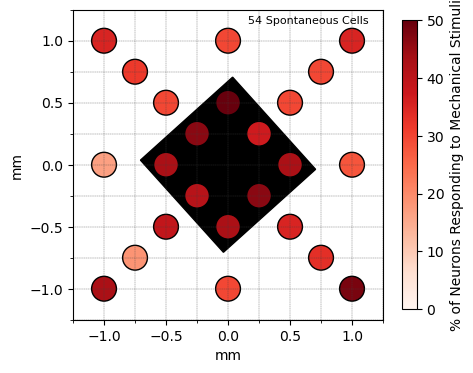

# of Responses at each location: [16, 19, 15, 26, 16, 23, 9, 19, 17, 16, 18, 10, 32, 16, 23, 19, 23, 21, 23, 16, 25, 20, 25, 22]


In [29]:
allData = []

for item in cellDataList:
    if item['Responder?'] == "Spontaneous Cell" and item['Plexus'] == "MYP":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        dataList = []

        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))

            
        for i in range(24):
            if bin_List[i] == 1:
                if avgFstim[i] > avgFbase[i]:
                    dataList.append(1)
                else:
                    dataList.append(0)
            else:
                dataList.append(0)
            
        allData.append(dataList)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)


for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds']((2*popData[i]/len(allData))))
        ax.add_artist(c)

# Display Cell
#cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
#ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=50), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.65, 1.2, str(len(allData)) + ' Spontaneous Cells', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

print("MYP Spontaneous Cells")
plt.show()

print("# of Responses at each location: " + str(popData))

## ONLY SMP Spontaneous Cells

SMP Spontaneous Cells


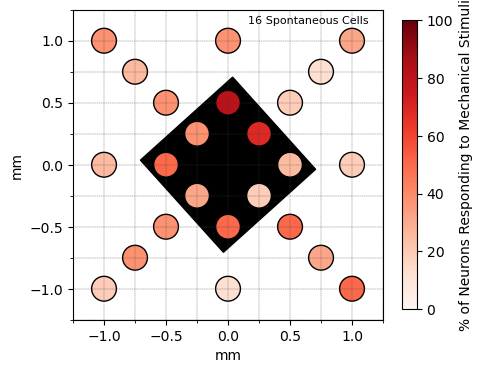

# of Responses at each location: [6, 5, 3, 8, 2, 3, 4, 6, 4, 2, 5, 6, 13, 3, 4, 8, 8, 6, 8, 6, 6, 11, 3, 5]


In [30]:
allData = []

for item in cellDataList:
    if item['Responder?'] == "Spontaneous Cell" and item['Plexus'] == "SMP":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        dataList = []

        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))

            
        for i in range(24):
            if bin_List[i] == 1:
                if avgFstim[i] > avgFbase[i]:
                    dataList.append(1)
                else:
                    dataList.append(0)
            else:
                dataList.append(0)
            
        allData.append(dataList)
        
# Making List of # of Responses        
popData = []
for g in range(24):
    sum = 0
    for f in range(len(allData)):
        sum = sum + allData[f][g]
    popData.append(sum)
        
# Population Plot

xgrid = np.arange(-1, 1, 0.25)
ygrid = np.arange(-1, 1, 0.25)
    
fig, ax = plt.subplots(figsize=(5,5))

ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
ax.add_artist(r)


for i in range(len(stimLocations)):
    if popData[i] == 0:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
        ax.add_artist(c)
    else:
        c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor= plt.colormaps['Reds']((popData[i]/len(allData))))
        ax.add_artist(c)

# Display Cell
#cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
#ax.add_artist(cell)

fig.colorbar(plt.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=100), cmap= 'Reds'), ax = ax, \
             shrink = 0.75).set_label(label='% of Neurons Responding to Mechanical Stimuli', size=10)

ax.set_xlabel('mm', fontsize = 10)    
ax.set_ylabel('mm', fontsize = 10)
#ax.set_title('Mechanical Response Grid')

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(0.25))
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.xaxis.set_major_locator(MultipleLocator(0.5))

ax.tick_params(labelsize = 10)

ax.set_xlim([-1.25, 1.25])
ax.set_ylim([-1.25, 1.25])

ax.set_aspect(1.0)

#ax.text(-1, 1.2, "", ha='center', va='top', color='black', size = 8)

ax.text(0.65, 1.2, str(len(allData)) + ' Spontaneous Cells', ha='center', va='top', color='black', size = 8)


#ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)

print("SMP Spontaneous Cells")
plt.show()

print("# of Responses at each location: " + str(popData))

# Response Grids for Spontaneous Cells

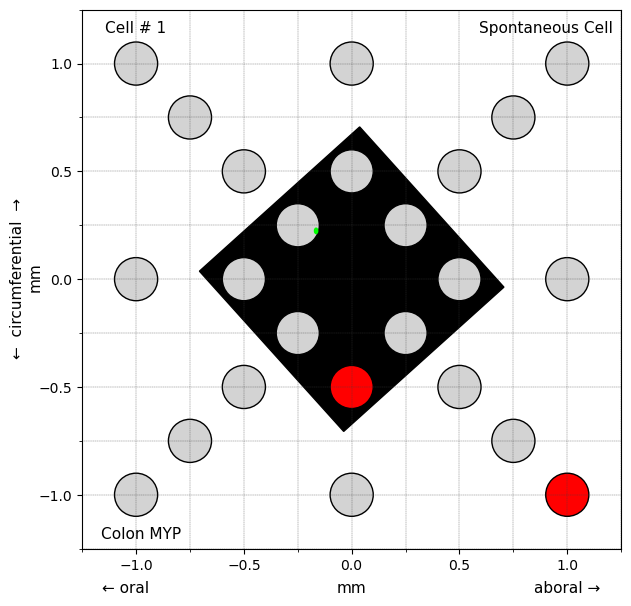

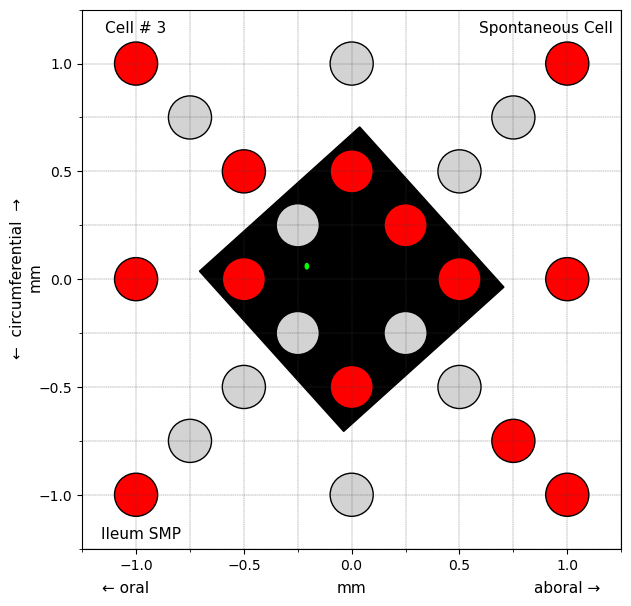

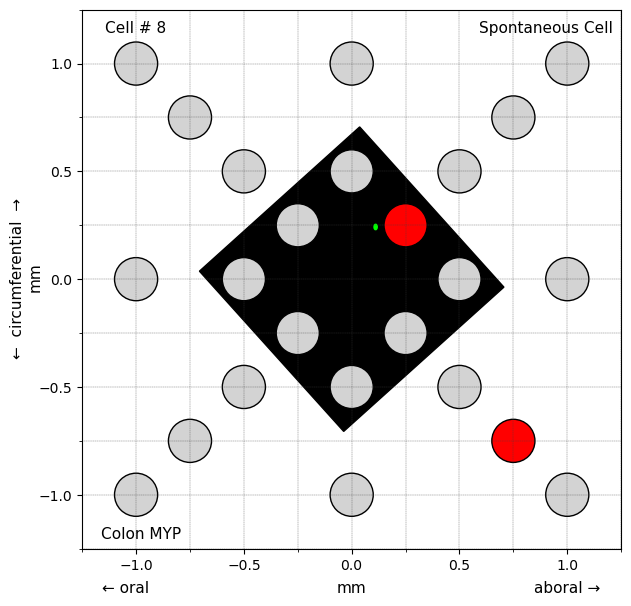

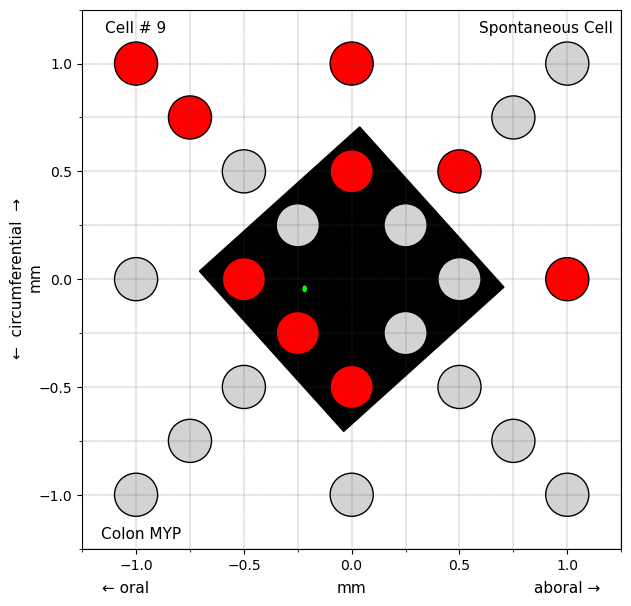

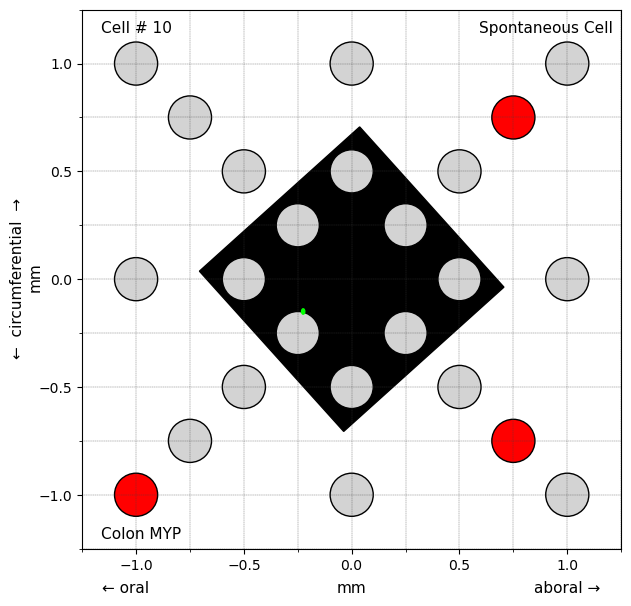

...

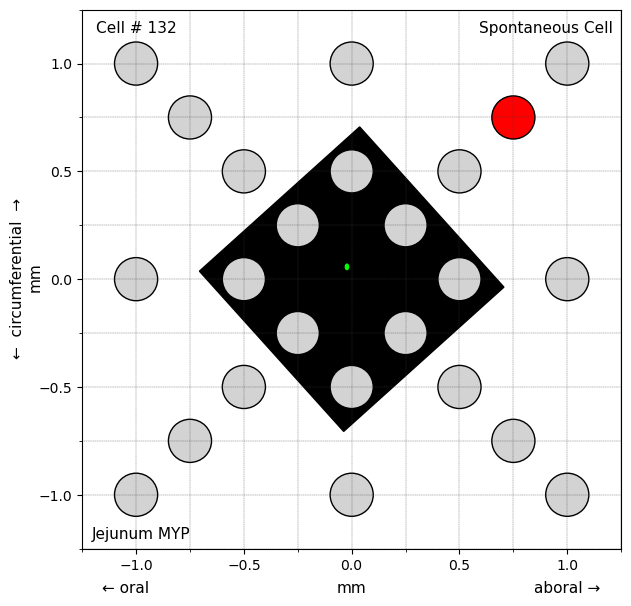

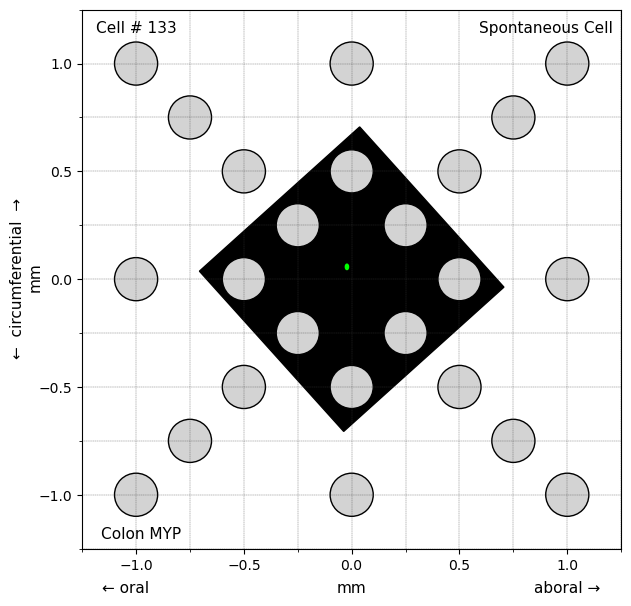

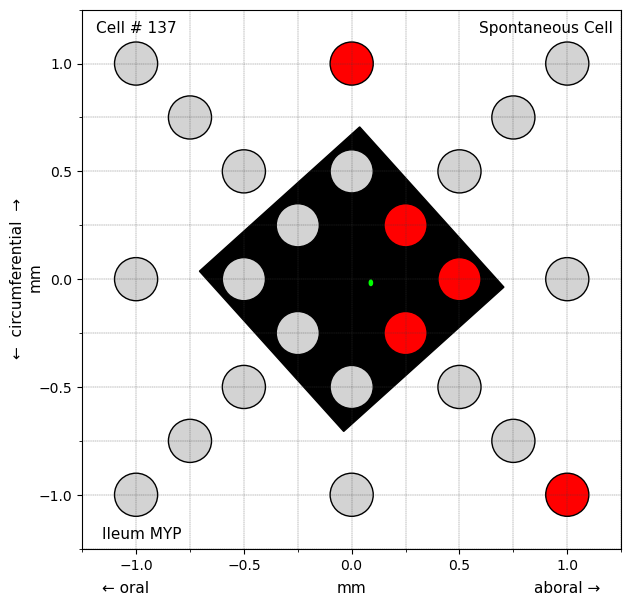

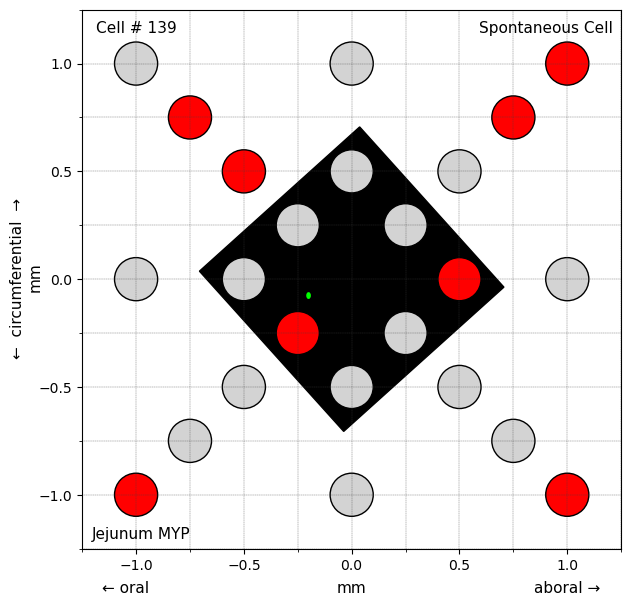

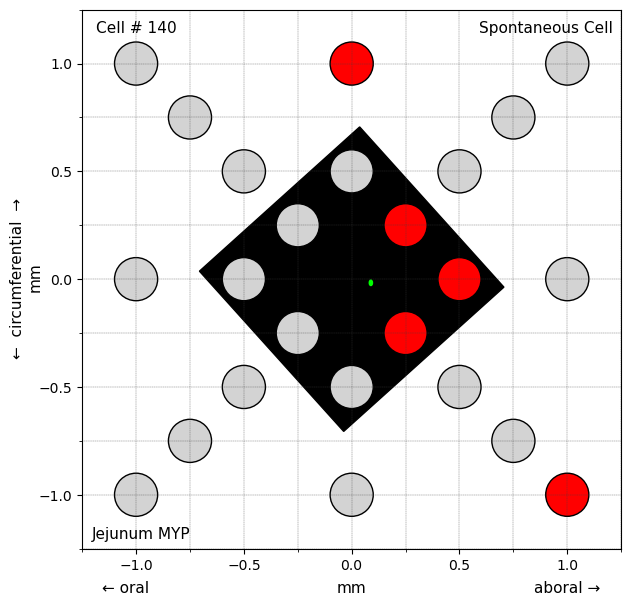

In [31]:
cellNum = 0


for item in cellDataList:
    cellNum = cellNum + 1
    
    if item['Responder?'] == "Spontaneous Cell":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        
        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))

        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)


        fig, ax = plt.subplots(figsize=(7,7))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
        ax.add_artist(r)
        
        for i in range(24):
            if bin_List[i] == 1:
                if avgFstim[i] > avgFbase[i]:
                    c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='red')
                    ax.add_artist(c)
                else:
                    c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                    ax.add_artist(c)
            else:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        #ax.set_xlabel('mm', fontsize = 10)    
        #ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 11)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 11)

        if item['Responder?'] == "Spontaneous Cell":
            ax.text(0.9, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 11)
        elif item['Responder?'] == "Yes":
            ax.text(0.9, 1.2, 'Responder', ha='center', va='top', color='black', size = 11)
        else:
            ax.text(0.9, 1.2, 'Non-Responder', ha='center', va='top', color='black', size = 11)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)
        
        ax.text(-1.05, -1.4, "\u2190 oral", ha='center', va='top', color='black', size = 11)
        ax.text(1, -1.4, "aboral \u2192", ha='center', va='top', color='black', size = 11)
        ax.text(0, -1.4, "mm", ha='center', va='top', color='black', size = 11)
        ax.text(-1.55, 0.38, "\u2190  circumferential  \u2192", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
        ax.text(-1.47, 0.08, "mm", ha='center', va='top', color='black', size = 11, rotation = 'vertical')

        plt.show()

# Calculating Avg Freq of Baseline vs Response for Spon Cells

In [32]:
from statistics import mean 
allBaseAvg = []
allStimAvg = []

for item in cellDataList:
    if item['Responder?'] == "Spontaneous Cell":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        baseList = []
        stimList = []

        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))

            
        for i in range(24):
            if bin_List[i] == 1:
                if avgFstim[i] > avgFbase[i]:
                    baseList.append(avgFbase[i])
                    stimList.append(avgFstim[i])
        
        if baseList != []:
            allBaseAvg.append(mean(baseList))
            allStimAvg.append(mean(stimList))

print("Baseline Avg List:")
print(allBaseAvg)
print("Stim Avg List:")
print(allStimAvg)

Baseline Avg List:
[0.0, 0.48307692307692307, 0.025, 0.9600000000000001, 0.0, 0.11428571428571428, 0.0, 0.060000000000000005, 0.4926666666666667, 1.3707142857142858, 0.0, 0.025, 0.255, 0.4027272727272727, 0.025, 0.04, 0.04, 0.822, 0.3572727272727273, 0.23285714285714285, 1.2771428571428571, 0.045454545454545456, 0.05555555555555556, 0.025, 0.5714285714285714, 1.1, 0.047, 0.045714285714285714, 1.1861538461538461, 0.6616666666666666, 1.2, 0.9716666666666667, 0.6608333333333334, 0.688, 1.001111111111111, 1.3742857142857143, 1.3492857142857144, 1.1, 0.08363636363636363, 0.065, 0.008333333333333333, 0.04, 0.8838461538461538, 0.30357142857142855, 0.48142857142857143, 1.486, 0.04, 0.02666666666666667, 0.04, 0.04, 0.022222222222222223, 0.0, 0.0, 0.0, 0.0, 0.08363636363636363, 0.047, 0.07454545454545454, 0.08363636363636363, 0.065, 0.4969230769230769, 0.15666666666666668, 0.17200000000000001, 0.17200000000000001, 0.13333333333333333, 0.0, 0.0, 0.16875, 0.0]
Stim Avg List:
[0.12000000000000001, 

# Calculating Avg Freq of Baseline vs Response for Responding Cells

In [33]:
from statistics import mean 
allBaseAvg = []
allStimAvg = []

for item in cellDataList:
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        data = item['25s Mech Stim Window Binary'][1:-1]
        data2 = item['ROI Coords'][1:-1]
        data3 = item['Avg Freq Pre Stim'][1:-1]
        data4 = item['Avg Freq 25s Mech Stim Window'][1:-1]

        split_char1 = ","

        bin_List = []
        cellBody = []
        avgFbase = []
        avgFstim = []
        baseList = []
        stimList = []

        nextValue = data.split(split_char1)
        nextValue2 = data2.split(split_char1)
        nextValue3 = data3.split(split_char1)
        nextValue4 = data4.split(split_char1)
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            bin_List.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            cellBody.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            avgFbase.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            avgFstim.append(float(nextValue4[i]))

            
        for i in range(24):
            if bin_List[i] == 1: 
                baseList.append(avgFbase[i])
                stimList.append(avgFstim[i])
        
        if baseList != []:
            allBaseAvg.append(mean(baseList))
            allStimAvg.append(mean(stimList))

print("Baseline Avg List:")
print(allBaseAvg)
print("Stim Avg List:")
print(allStimAvg)
print(mean(allStimAvg))

Baseline Avg List:
[0.0, 0.0, 0.0, 0.024999999999999998, 0.0, 0.016666666666666666, 0.016666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.016666666666666666, 0.0, 0.05, 0.0, 0.0, 0.19999999999999998]
Stim Avg List:
[0.05, 0.08, 0.21333333333333332, 0.10666666666666666, 0.08, 0.08, 0.08, 0.04, 0.04, 0.04, 0.04, 0.06666666666666667, 0.06666666666666667, 0.07333333333333333, 0.06666666666666667, 0.08, 0.08, 0.08, 0.09333333333333334]
0.07666666666666666


# Making Responder plots w/ spots color coded by latency of response. At Bottom is list of # of Responding Spots (categorized by MYP vs SMP)

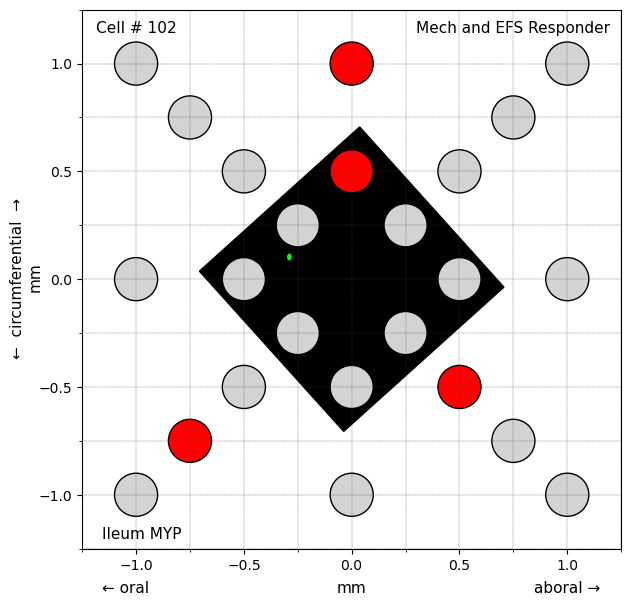

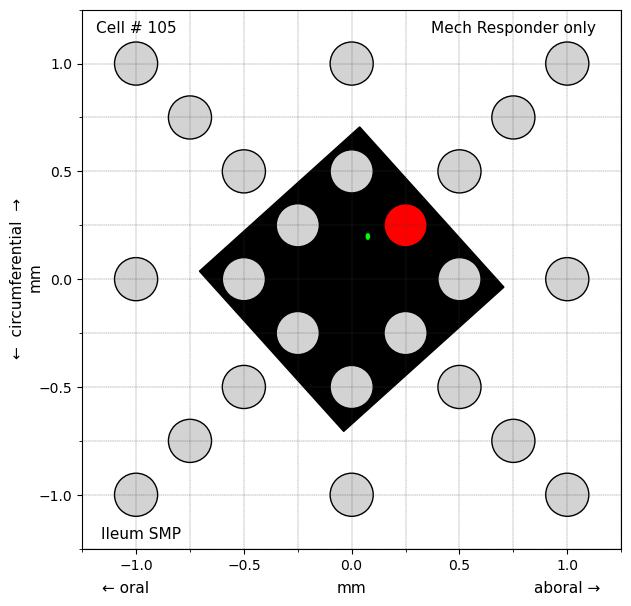

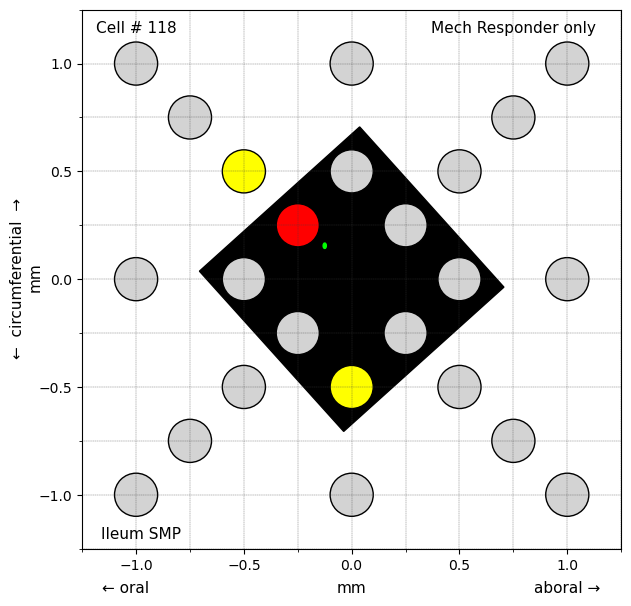

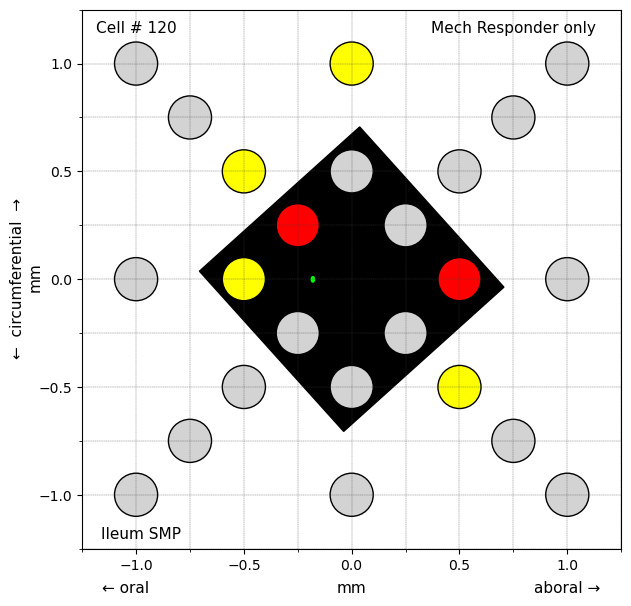

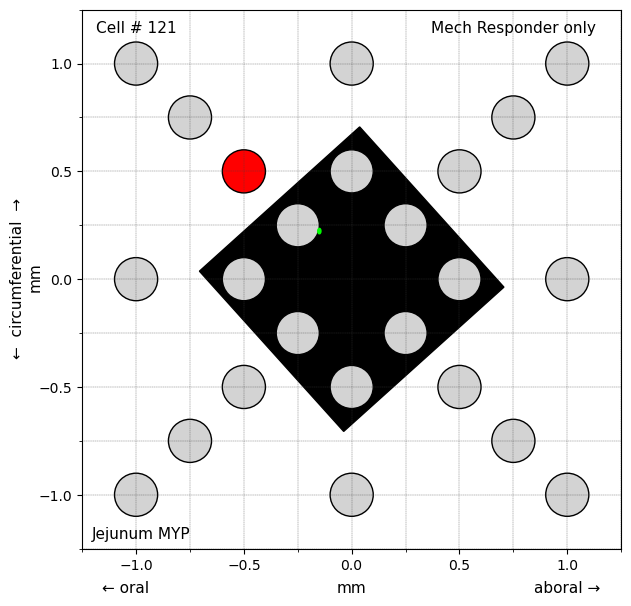

...

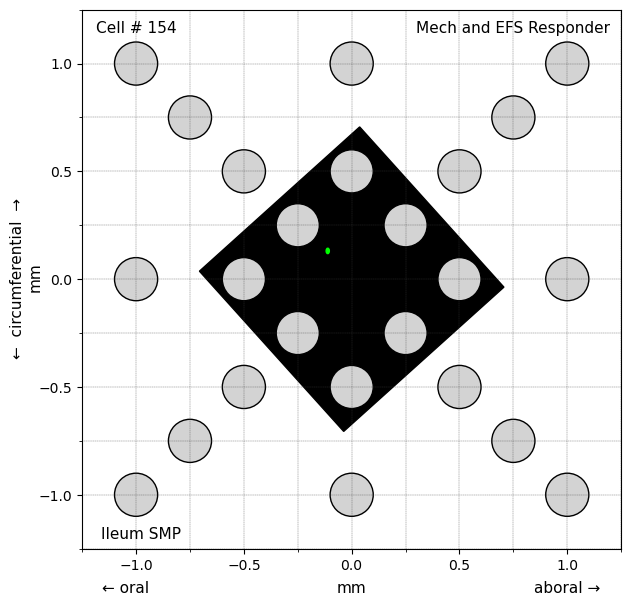

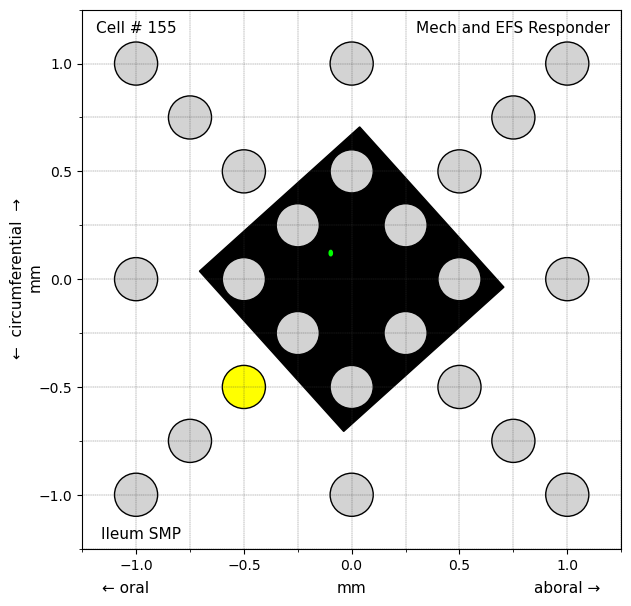

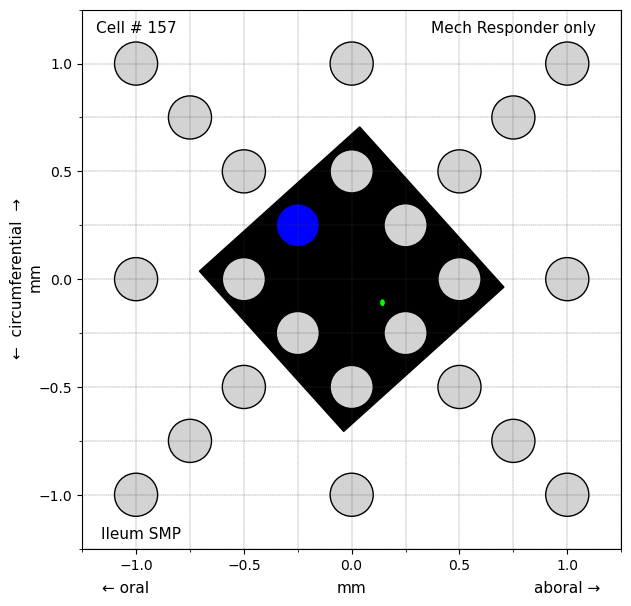

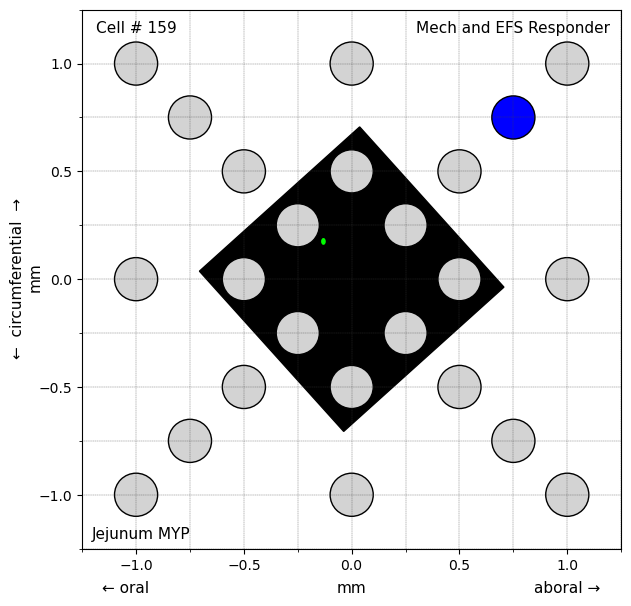

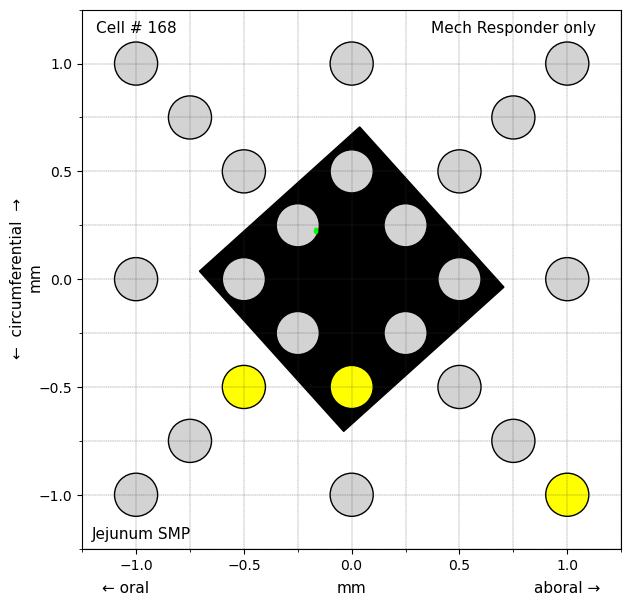

# of Responders:  30
# of Spots in 25s period:  [4, 1, 3, 6, 1, 3, 3, 0, 1, 8, 7, 1, 3, 3, 6, 3, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 3]
# of Spots in 45s period:  [4, 1, 3, 6, 1, 3, 3, 0, 1, 8, 7, 1, 3, 3, 6, 3, 4, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 3]
MYP # of Spots in 25s period:  [4, 1, 3, 3, 0, 8, 7, 1, 3, 3, 6, 0]
MYP # of Spots in 45s period:  [4, 1, 3, 3, 0, 8, 7, 1, 3, 3, 6, 1]
SMP # of Spots in 25s period:  [1, 3, 6, 1, 3, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 3]
SMP # of Spots in 45s period:  [1, 3, 6, 1, 3, 4, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 3]


In [34]:
cellNum = 0
respNum = 0
num25Spots = []
num45Spots = []
num25SpotsMYP = []
num45SpotsMYP = []
num25SpotsSMP = []
num45SpotsSMP = []


for item in cellDataList:
    
    cellNum = cellNum + 1
    
    spotCounter25 = 0
    spotCounter45 = 0
    spotCounter25MYP = 0
    spotCounter45MYP = 0
    spotCounter25SMP = 0
    spotCounter45SMP = 0
    
    if item['Responder?'] == "Mech Responder only" or item['Responder?'] =="Mech and EFS Responder":
        stimBin = item['25s Mech Stim Window Binary'][1:-1]
        postBin = item['20s Post Stim Window Binary'][1:-1]
        stimLat = item['Step 1 Latency to Spike in Stim Window'][1:-1]
        postLat = item['Step 1 Latency to Spike in Post Stim Window'][1:-1]
        roi = item['ROI Coords'][1:-1]
        
        split_char1 = ","

        stimBinList = []
        postBinList = []
        stimLatList = []
        postLatList = []
        cellBody = []

        nextValue = stimBin.split(split_char1)
        nextValue2 = postBin.split(split_char1)
        nextValue3 = stimLat.split(split_char1)
        nextValue4 = postLat.split(split_char1)
        nextValue5 = roi.split(split_char1)
        
        #The loop that cleans each file and adds intensity for each line into intensityList
        for i in range(len(nextValue)):
            stimBinList.append(float(nextValue[i]))
        for i in range(len(nextValue2)):
            postBinList.append(float(nextValue2[i]))
        for i in range(len(nextValue3)):
            stimLatList.append(float(nextValue3[i]))
        for i in range(len(nextValue4)):
            postLatList.append(float(nextValue4[i]))
        for i in range(len(nextValue5)):
            cellBody.append(float(nextValue5[i]))

            
        xgrid = np.arange(-1, 1, 0.25)
        ygrid = np.arange(-1, 1, 0.25)


        fig, ax = plt.subplots(figsize=(7,7))

        ax.grid(linestyle="--", linewidth=0.25, color='.25', which='both')

        r = Rectangle((-0.5,-0.5), 1, 1, edgecolor='black', facecolor='black', angle = 42, rotation_point='center')
        ax.add_artist(r)
        

        for i in range(24):
            if stimBinList[i] == 0 and postBinList[i] == 0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='lightgray')
                ax.add_artist(c)
            elif stimBinList[i] == 1 and stimLatList[i] < 0.5:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='red')
                ax.add_artist(c)
                spotCounter25 = spotCounter25 + 1
                spotCounter45 = spotCounter45 + 1
                if item['Plexus'] == "MYP":
                    spotCounter25MYP = spotCounter25MYP + 1
                    spotCounter45MYP = spotCounter45MYP + 1
                elif item['Plexus'] == "SMP":
                    spotCounter25SMP = spotCounter25SMP + 1
                    spotCounter45SMP = spotCounter45SMP + 1
                    
            elif stimBinList[i] == 1 and stimLatList[i] > 0.5:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='yellow')
                ax.add_artist(c)
                spotCounter25 = spotCounter25 + 1
                spotCounter45 = spotCounter45 + 1
                if item['Plexus'] == "MYP":
                    spotCounter25MYP = spotCounter25MYP + 1
                    spotCounter45MYP = spotCounter45MYP + 1
                elif item['Plexus'] == "SMP":
                    spotCounter25SMP = spotCounter25SMP + 1
                    spotCounter45SMP = spotCounter45SMP + 1
                    
            elif stimBinList[i] == 0 and postBinList[i] == 1.0:
                c = Circle((stimLocations[i][0], stimLocations[i][1]), radius=0.1, edgecolor='black', facecolor='blue')
                ax.add_artist(c)
                spotCounter45 = spotCounter45 + 1
                if item['Plexus'] == "MYP":
                    spotCounter45MYP = spotCounter45MYP + 1
                elif item['Plexus'] == "SMP":
                    spotCounter45SMP = spotCounter45SMP + 1

        # Display Cell
        cell = Ellipse((cellBody[0],cellBody[1]), 0.015, 0.025, edgecolor='lime', facecolor='lime')
        ax.add_artist(cell)

        #ax.set_xlabel('mm', fontsize = 10)    
        #ax.set_ylabel('mm', fontsize = 10)
        #ax.set_title('Mechanical Response Grid')

        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        ax.xaxis.set_minor_locator(MultipleLocator(0.25))
        ax.yaxis.set_major_locator(MultipleLocator(0.5))
        ax.xaxis.set_major_locator(MultipleLocator(0.5))

        ax.tick_params(labelsize = 10)

        ax.set_xlim([-1.25, 1.25])
        ax.set_ylim([-1.25, 1.25])

        ax.set_aspect(1.0)

        ax.text(-1, 1.2,"Cell # " + str(cellNum), ha='center', va='top', color='black', size = 11)
        ax.text(-0.975, -1.15, item['GI Region'] + " " + item['Plexus'], ha='center', va='top', color='black', size = 11)

        ax.text(0.75, 1.2, item['Responder?'], ha='center', va='top', color='black', size = 11)

        #ax.text(0.8, 0.3, 'Red = Mechanical Response', ha='center', va='top', color='black', size = 10)
        ax.text(-1.05, -1.4, "\u2190 oral", ha='center', va='top', color='black', size = 11)
        ax.text(1, -1.4, "aboral \u2192", ha='center', va='top', color='black', size = 11)
        ax.text(0, -1.4, "mm", ha='center', va='top', color='black', size = 11)
        ax.text(-1.55, 0.38, "\u2190  circumferential  \u2192", ha='center', va='top', color='black', size = 11, rotation = 'vertical')
        ax.text(-1.47, 0.08, "mm", ha='center', va='top', color='black', size = 11, rotation = 'vertical')

        plt.show()
        
        respNum = respNum + 1
        num25Spots.append(spotCounter25)
        num45Spots.append(spotCounter45)
        if item['Plexus'] == "MYP":
            num25SpotsMYP.append(spotCounter25MYP)
            num45SpotsMYP.append(spotCounter45MYP)
        if item['Plexus'] == "SMP":
            num25SpotsSMP.append(spotCounter25SMP)
            num45SpotsSMP.append(spotCounter45SMP)
        
print("# of Responders: ", respNum)
print("# of Spots in 25s period: ", num25Spots)
print("# of Spots in 45s period: ", num45Spots)
print("MYP # of Spots in 25s period: ", num25SpotsMYP)
print("MYP # of Spots in 45s period: ", num45SpotsMYP)
print("SMP # of Spots in 25s period: ", num25SpotsSMP)
print("SMP # of Spots in 45s period: ", num45SpotsSMP)